# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [15]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [16]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(self.make_gen_block(input_dim, hidden_dim * 4),
                                 self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
                                 self.make_gen_block(hidden_dim * 2, hidden_dim),
                                 self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True))

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                                 nn.Tanh())

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [17]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(self.make_disc_block(im_chan, hidden_dim),
                                  self.make_disc_block(hidden_dim, hidden_dim * 2),
                                  self.make_disc_block(hidden_dim * 2, 1, final_layer=True))

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                                 nn.BatchNorm2d(output_channels),
                                 nn.LeakyReLU(0.2, inplace=True))
        else:
            return nn.Sequential(nn.Conv2d(input_channels, output_channels, kernel_size, stride))

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [18]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    return F.one_hot(labels,n_classes)

Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [20]:
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    combined = torch.cat((x.float(),y.float()), 1)
    return combined

## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [22]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [23]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([transforms.ToTensor(), 
                                transforms.Normalize((0.5,), (0.5,))])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [24]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [26]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Epoch 1, step 500: Generator loss: 2.3339164432287216, discriminator loss: 0.24441832845285535


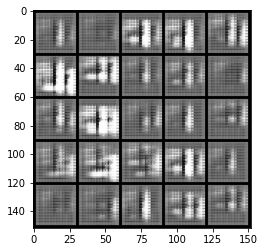

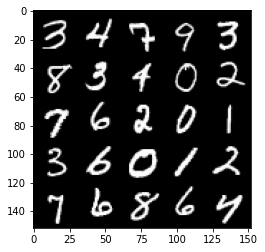

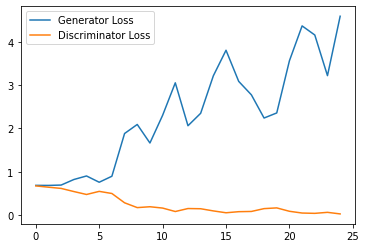

Epoch 2, step 1000: Generator loss: 4.00320991230011, discriminator loss: 0.0525022979453206


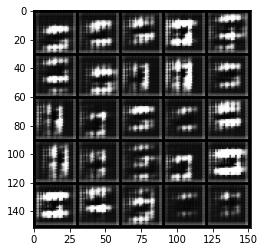

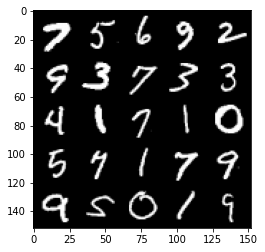

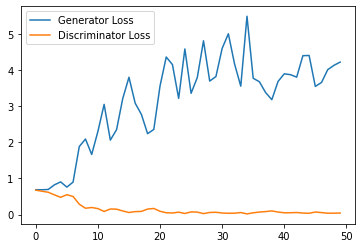

Epoch 3, step 1500: Generator loss: 3.833035995960236, discriminator loss: 0.0893523525511846


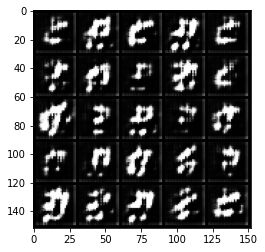

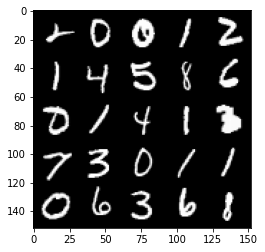

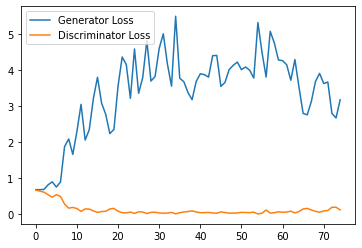

Epoch 4, step 2000: Generator loss: 3.2160115470886232, discriminator loss: 0.15359469110518695


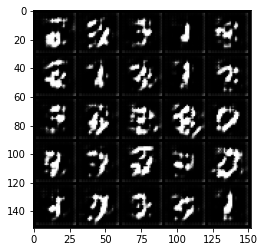

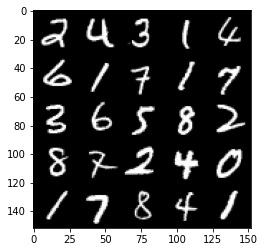

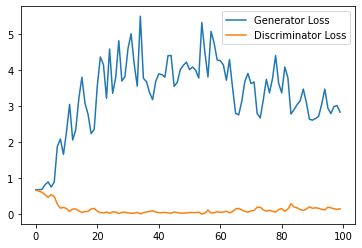

Epoch 5, step 2500: Generator loss: 2.69393146109581, discriminator loss: 0.23661965073645114


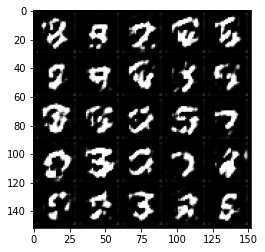

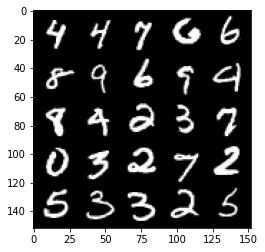

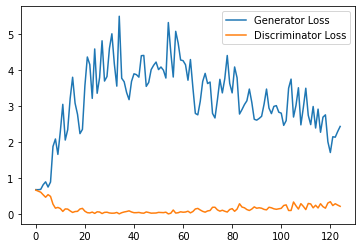

Epoch 6, step 3000: Generator loss: 2.2650519092082977, discriminator loss: 0.29486119937896726


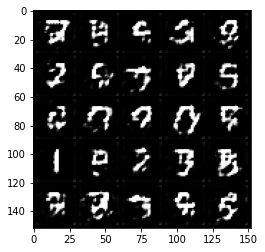

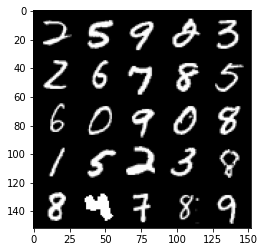

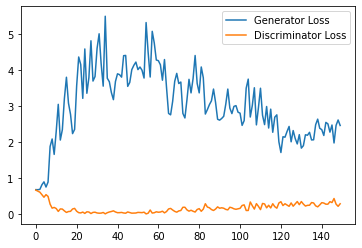

Epoch 7, step 3500: Generator loss: 2.297219522476196, discriminator loss: 0.2890704021900892


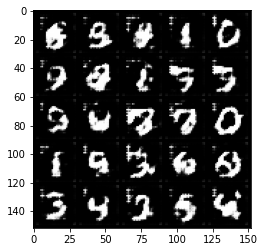

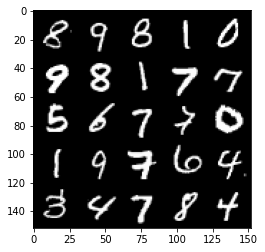

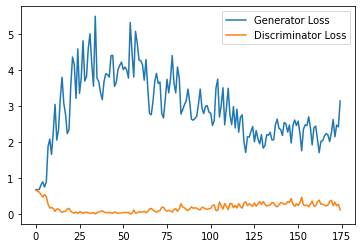

Epoch 8, step 4000: Generator loss: 2.11307008767128, discriminator loss: 0.30164610022306443


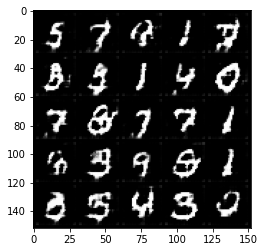

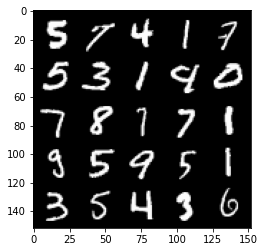

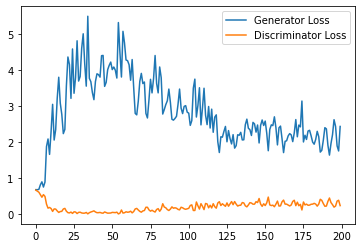

Epoch 9, step 4500: Generator loss: 2.207019616127014, discriminator loss: 0.32239892449975016


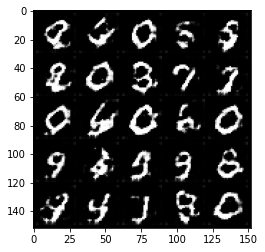

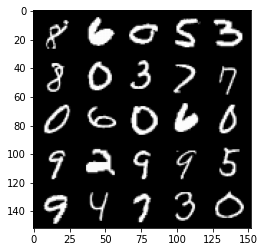

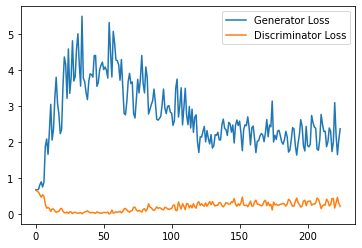

Epoch 10, step 5000: Generator loss: 1.8779610185623168, discriminator loss: 0.34368973955512044


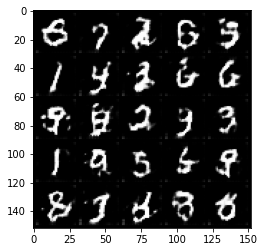

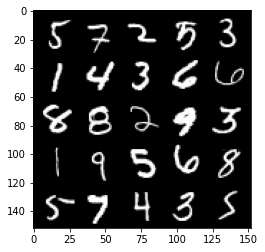

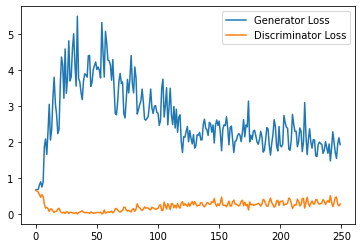

Epoch 11, step 5500: Generator loss: 1.7782053396701814, discriminator loss: 0.3959315497875214


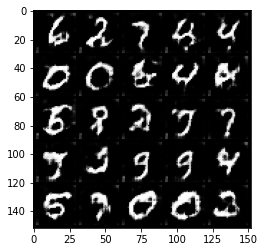

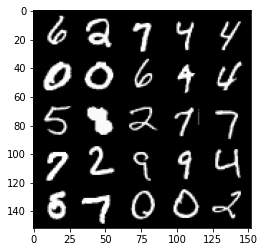

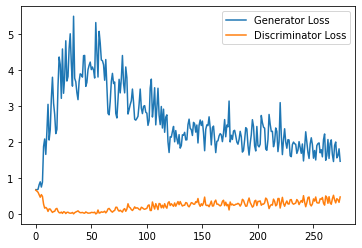

Epoch 12, step 6000: Generator loss: 1.6221701856851578, discriminator loss: 0.4597838869690895


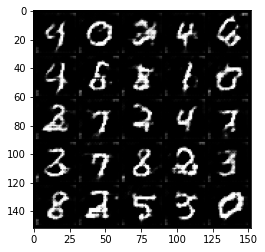

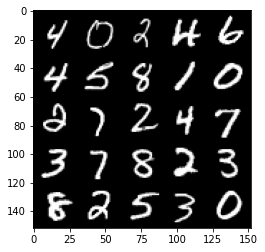

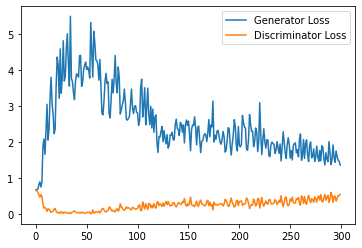

Epoch 13, step 6500: Generator loss: 1.4896335234642029, discriminator loss: 0.4502386539578438


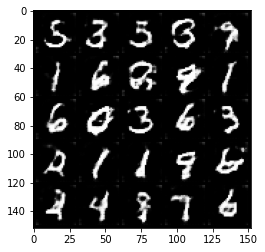

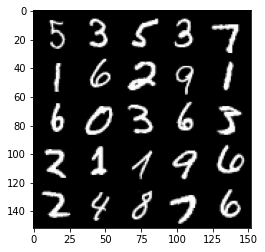

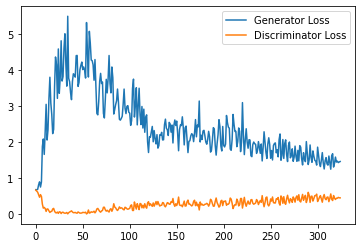

Epoch 14, step 7000: Generator loss: 1.4505004695653916, discriminator loss: 0.48964405876398087


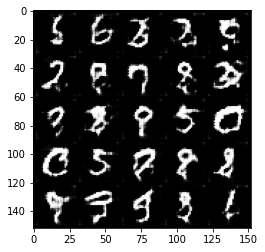

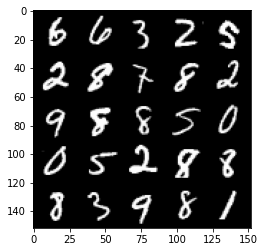

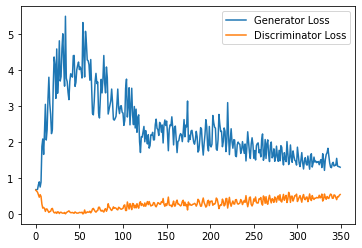

Epoch 15, step 7500: Generator loss: 1.3583224489688874, discriminator loss: 0.4931142793893814


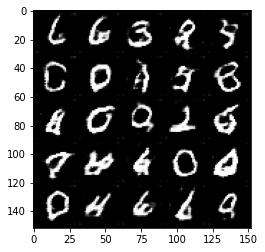

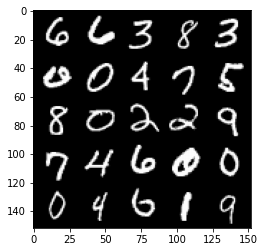

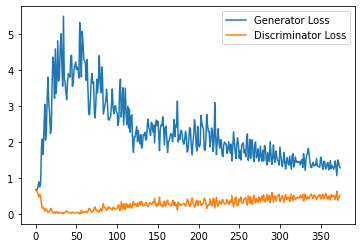

Epoch 17, step 8000: Generator loss: 1.367895421743393, discriminator loss: 0.5243433504700661


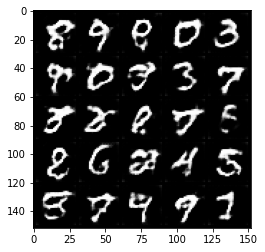

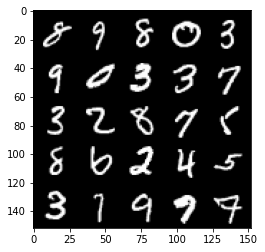

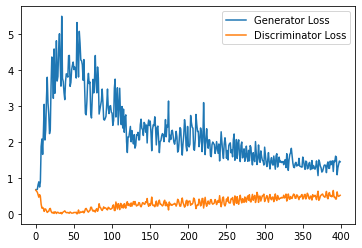

Epoch 18, step 8500: Generator loss: 1.309366735100746, discriminator loss: 0.5225566213726998


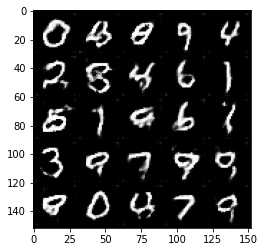

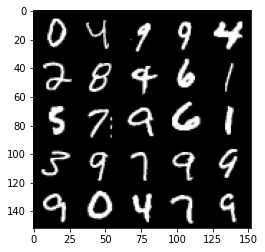

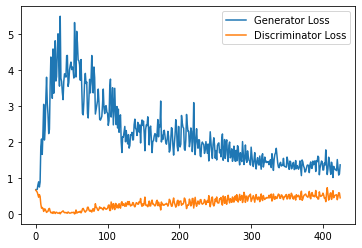

Epoch 19, step 9000: Generator loss: 1.24513050031662, discriminator loss: 0.5319550912380219


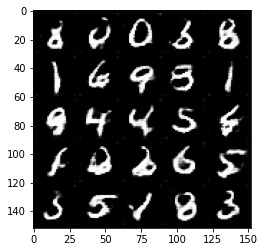

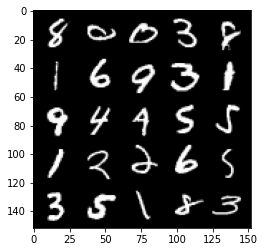

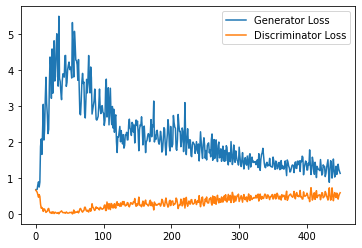

Epoch 20, step 9500: Generator loss: 1.2976876707077027, discriminator loss: 0.525522076189518


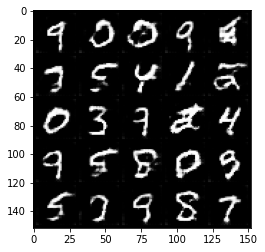

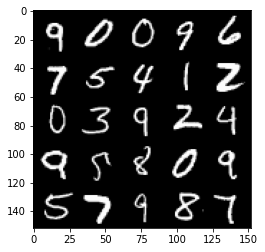

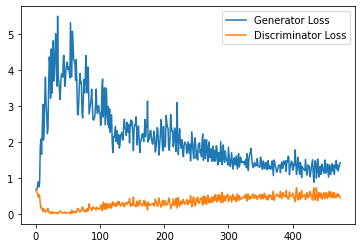

Epoch 21, step 10000: Generator loss: 1.2609004694223405, discriminator loss: 0.5359233330190182


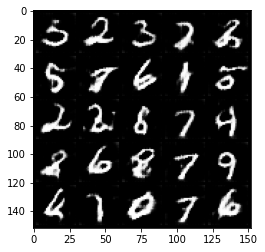

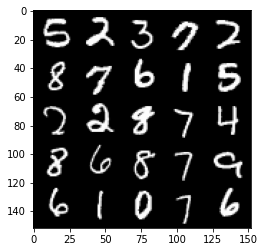

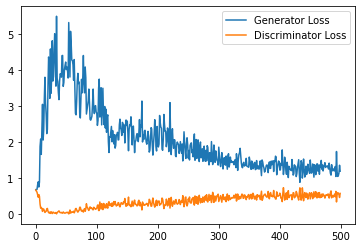

Epoch 22, step 10500: Generator loss: 1.2037595397233962, discriminator loss: 0.5462524104118347


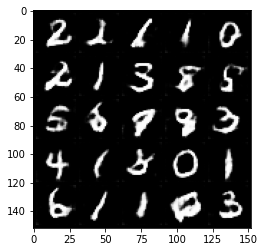

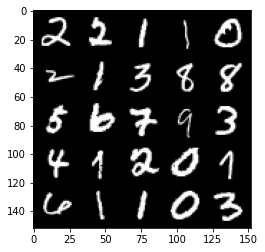

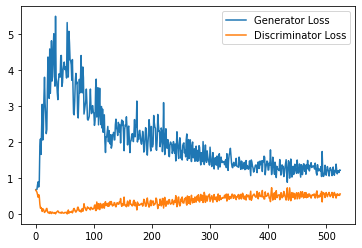

Epoch 23, step 11000: Generator loss: 1.2631470301151275, discriminator loss: 0.5402181437015533


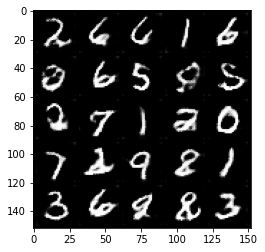

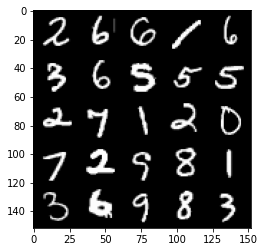

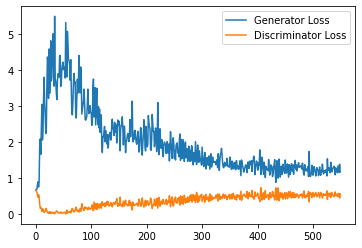

Epoch 24, step 11500: Generator loss: 1.2330976532697677, discriminator loss: 0.5479966704249382


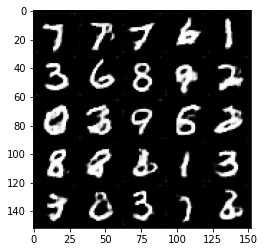

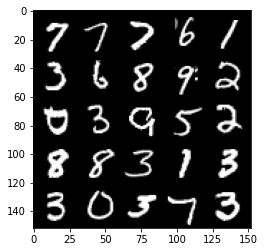

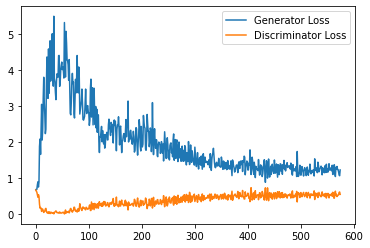

Epoch 25, step 12000: Generator loss: 1.1604484661817551, discriminator loss: 0.552862702190876


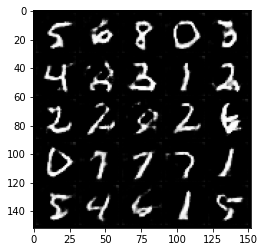

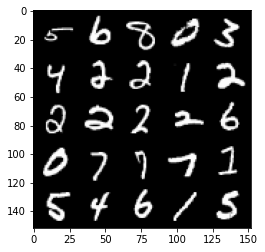

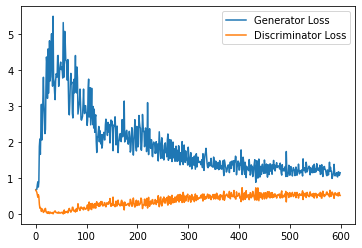

Epoch 26, step 12500: Generator loss: 1.1224159121513366, discriminator loss: 0.5581579120159149


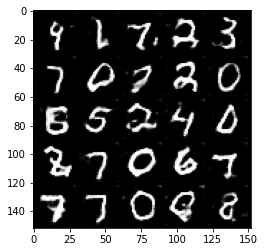

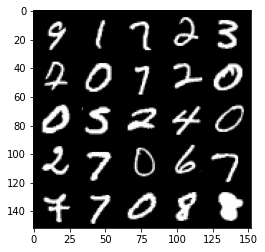

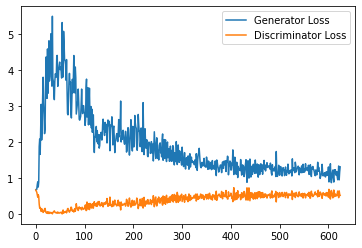

Epoch 27, step 13000: Generator loss: 1.12699822640419, discriminator loss: 0.5753412914276123


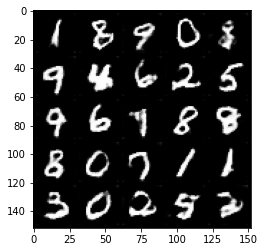

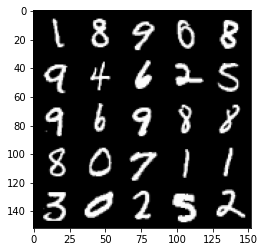

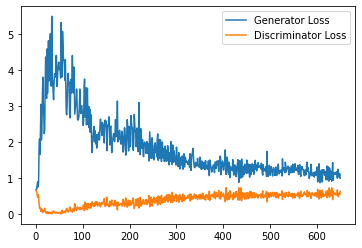

Epoch 28, step 13500: Generator loss: 1.1021082315444946, discriminator loss: 0.5795447362065316


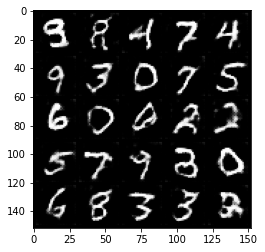

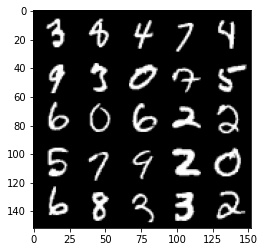

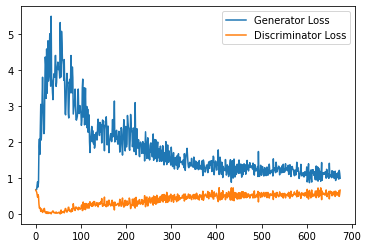

Epoch 29, step 14000: Generator loss: 1.1241950536966323, discriminator loss: 0.5743561143875122


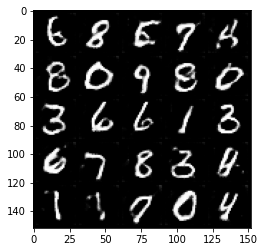

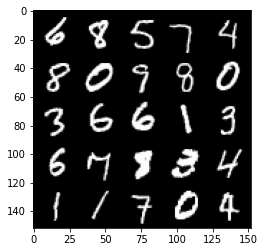

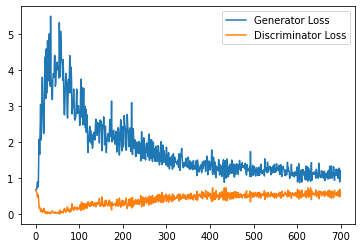

Epoch 30, step 14500: Generator loss: 1.1079284051656724, discriminator loss: 0.5854482375979424


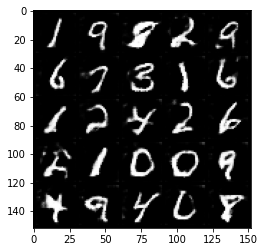

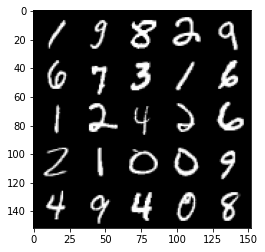

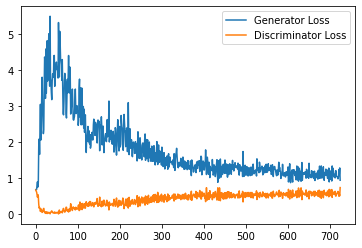

Epoch 31, step 15000: Generator loss: 1.0943366714715959, discriminator loss: 0.5774397563338279


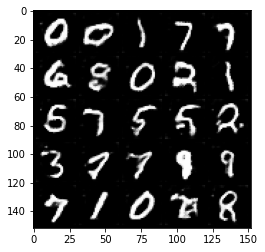

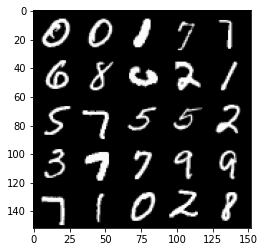

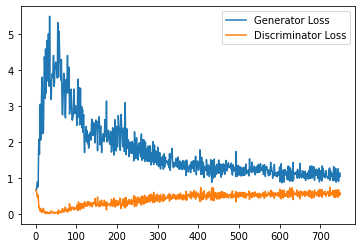

Epoch 33, step 15500: Generator loss: 1.0785744856595993, discriminator loss: 0.5856504948735237


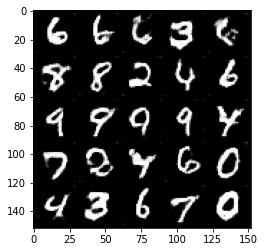

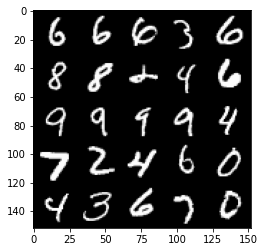

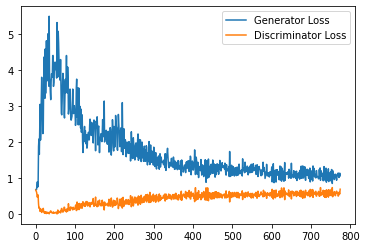

Epoch 34, step 16000: Generator loss: 1.1107676887512208, discriminator loss: 0.5769428586363793


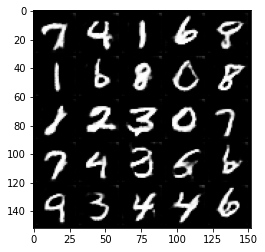

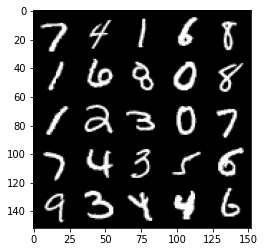

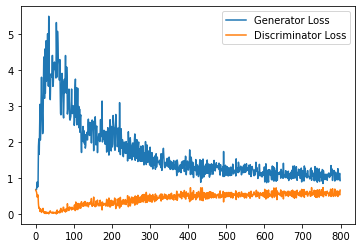

Epoch 35, step 16500: Generator loss: 1.0431471198797226, discriminator loss: 0.5824895574450493


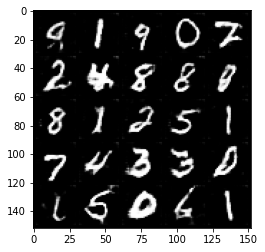

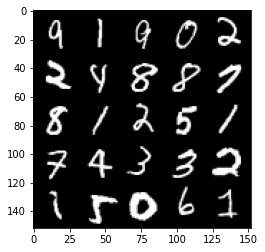

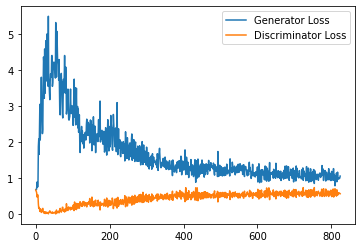

Epoch 36, step 17000: Generator loss: 1.0563102098703385, discriminator loss: 0.577748910009861


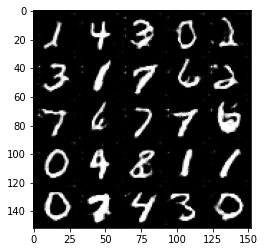

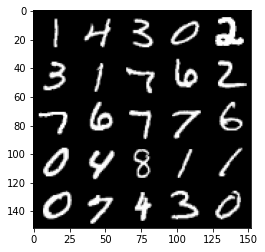

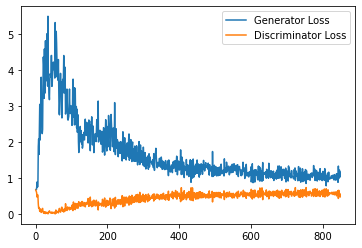

Epoch 37, step 17500: Generator loss: 1.0416613978147506, discriminator loss: 0.5848878689408302


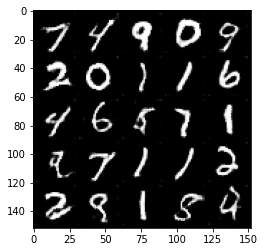

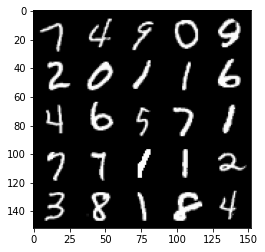

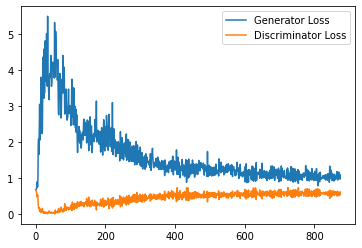

Epoch 38, step 18000: Generator loss: 1.0720925196409226, discriminator loss: 0.5815893120765686


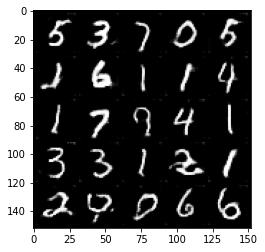

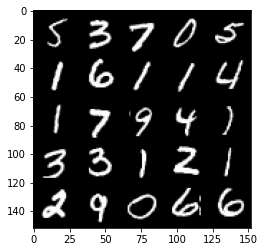

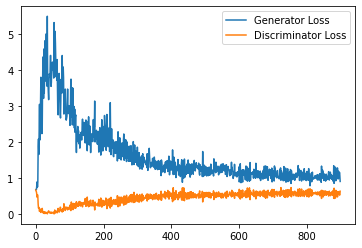

Epoch 39, step 18500: Generator loss: 1.0507115705013275, discriminator loss: 0.5799083766937256


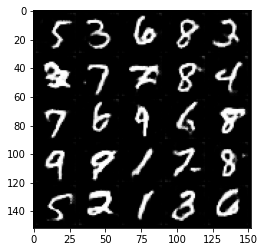

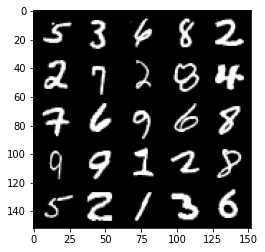

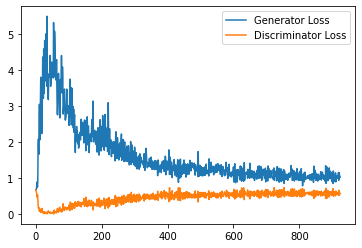

Epoch 40, step 19000: Generator loss: 1.0888716566562653, discriminator loss: 0.5742605966925621


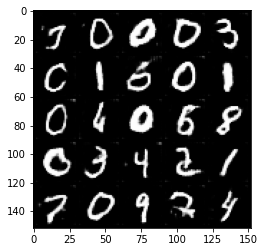

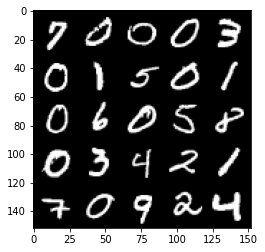

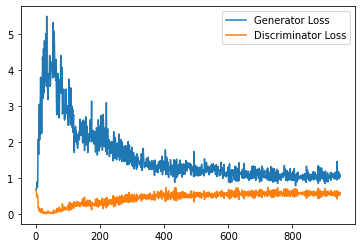

Epoch 41, step 19500: Generator loss: 1.022017237305641, discriminator loss: 0.5849485682249069


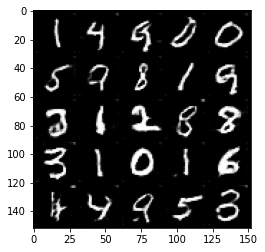

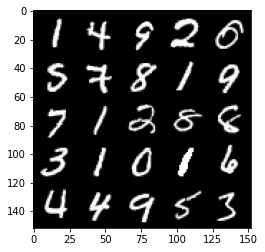

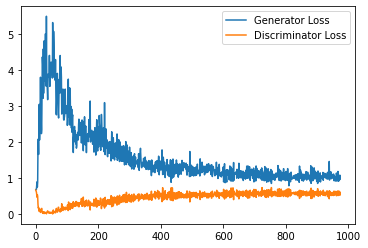

Epoch 42, step 20000: Generator loss: 1.0457257833480835, discriminator loss: 0.5729936408400536


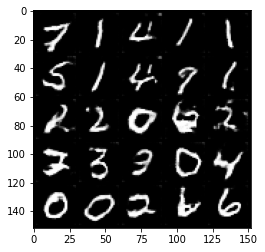

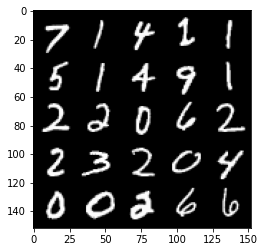

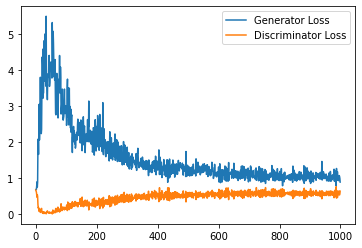

Epoch 43, step 20500: Generator loss: 1.046515431046486, discriminator loss: 0.5873539595007896


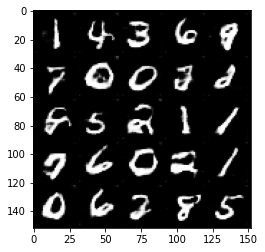

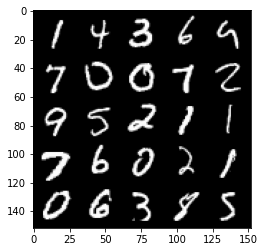

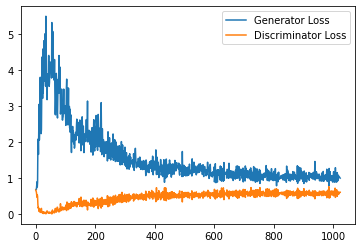

Epoch 44, step 21000: Generator loss: 1.0885145353078842, discriminator loss: 0.5753792793154716


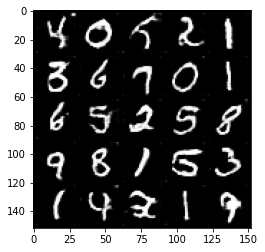

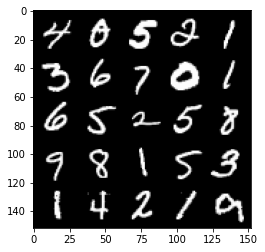

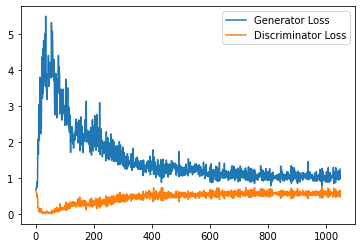

Epoch 45, step 21500: Generator loss: 1.05517218375206, discriminator loss: 0.5804224295616149


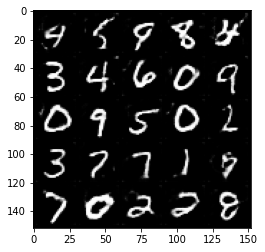

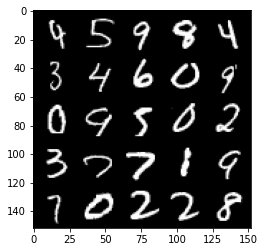

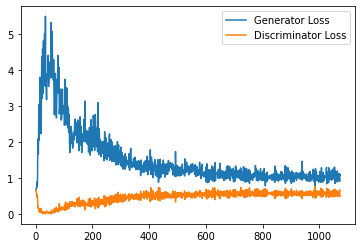

Epoch 46, step 22000: Generator loss: 1.0345999364852905, discriminator loss: 0.5767701823711395


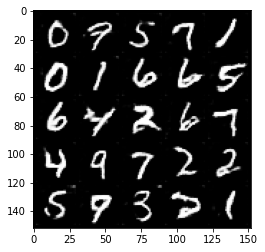

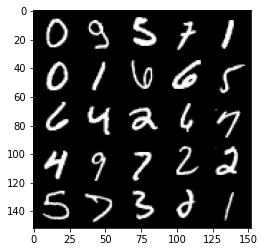

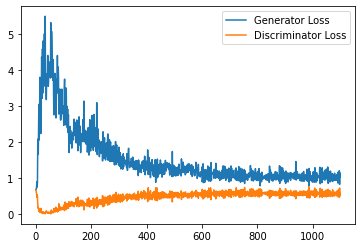

Epoch 47, step 22500: Generator loss: 1.0566715188026428, discriminator loss: 0.5771338536143303


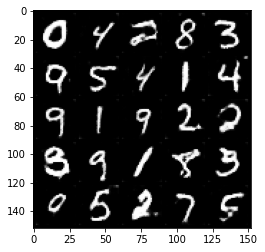

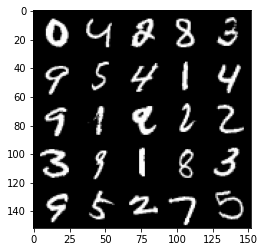

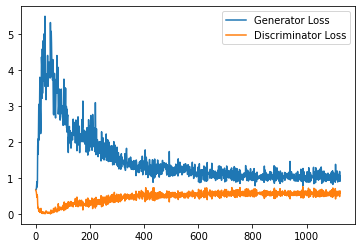

Epoch 49, step 23000: Generator loss: 1.058041744351387, discriminator loss: 0.5770051389932632


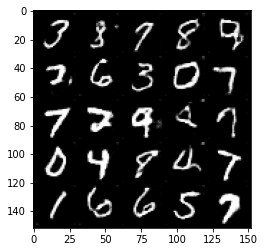

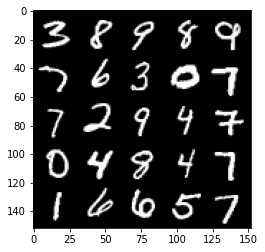

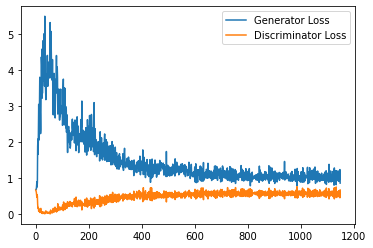

Epoch 50, step 23500: Generator loss: 1.0593811733722687, discriminator loss: 0.582108293056488


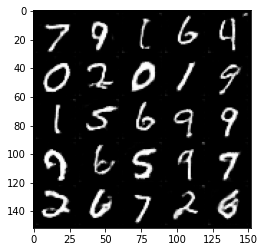

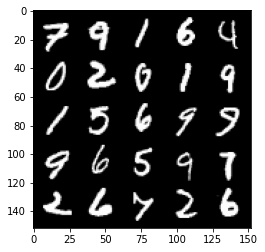

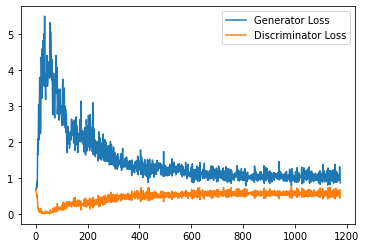

Epoch 51, step 24000: Generator loss: 1.043589662194252, discriminator loss: 0.5815351448655128


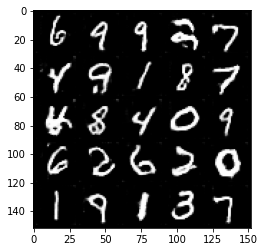

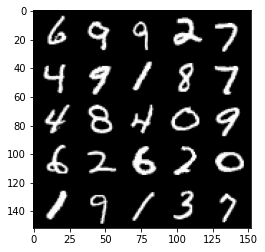

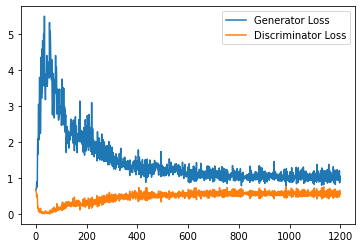

Epoch 52, step 24500: Generator loss: 1.0668285828828812, discriminator loss: 0.5718786590695382


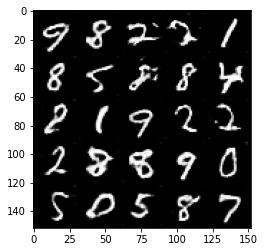

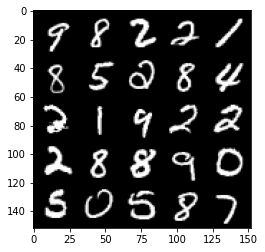

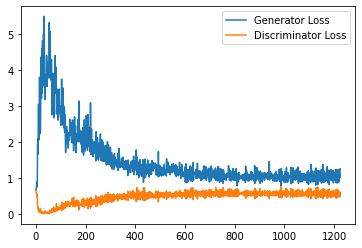

Epoch 53, step 25000: Generator loss: 1.0531238993406296, discriminator loss: 0.5769636592864991


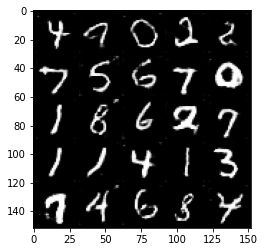

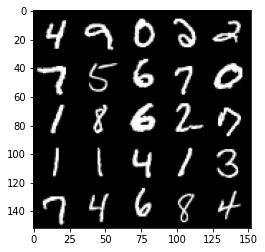

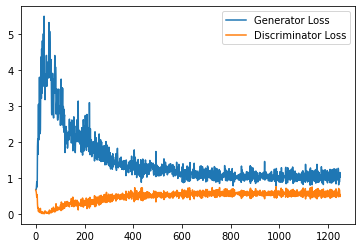

Epoch 54, step 25500: Generator loss: 1.0244232573509215, discriminator loss: 0.5814789142608643


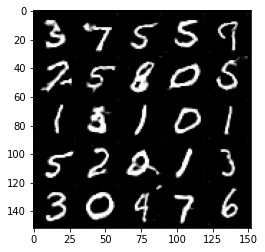

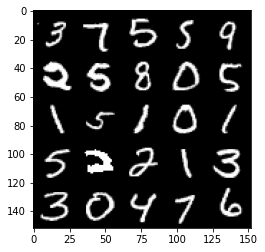

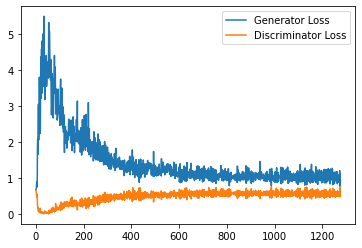

Epoch 55, step 26000: Generator loss: 1.0259372597932817, discriminator loss: 0.5832325885891915


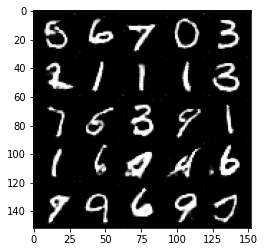

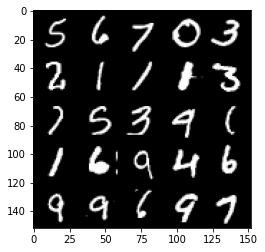

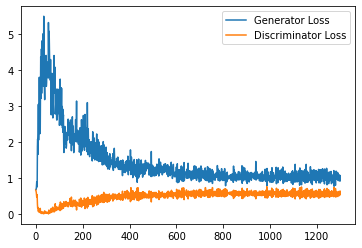

Epoch 56, step 26500: Generator loss: 1.08142376101017, discriminator loss: 0.5745031413435936


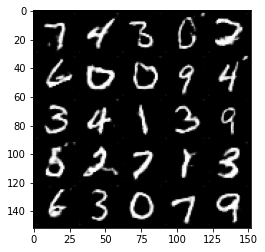

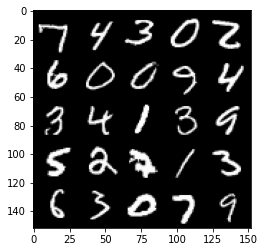

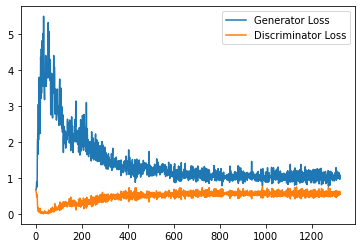

Epoch 57, step 27000: Generator loss: 1.0376326973438263, discriminator loss: 0.5831852831244468


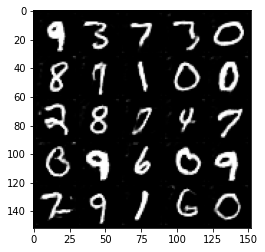

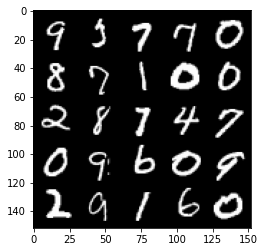

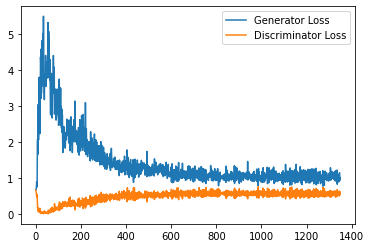

Epoch 58, step 27500: Generator loss: 1.0336518251895905, discriminator loss: 0.5793642935752868


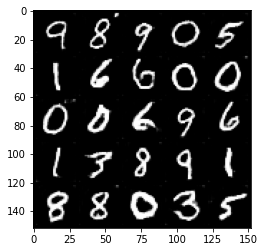

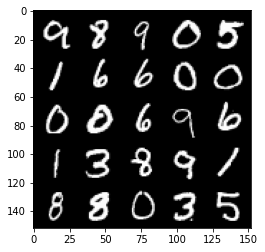

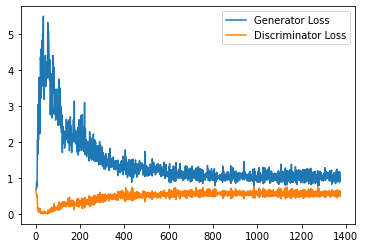

Epoch 59, step 28000: Generator loss: 1.0211998572349548, discriminator loss: 0.5814903985261917


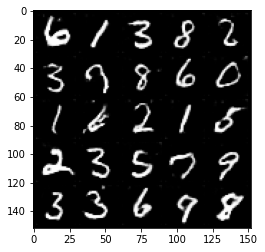

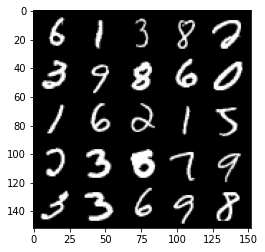

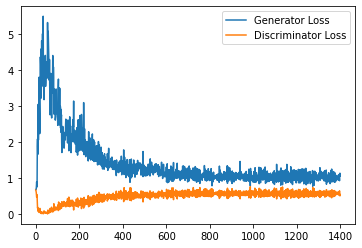

Epoch 60, step 28500: Generator loss: 1.0160818722248077, discriminator loss: 0.5914024628996849


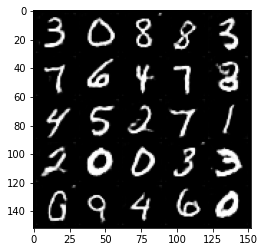

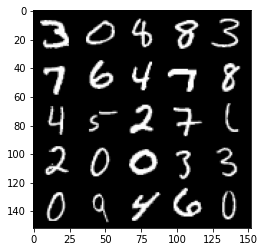

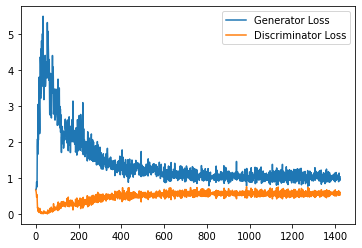

Epoch 61, step 29000: Generator loss: 1.019835953950882, discriminator loss: 0.59225537109375


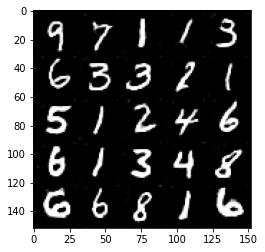

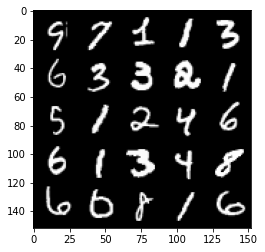

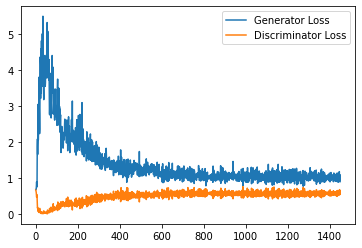

Epoch 62, step 29500: Generator loss: 1.0277187848091125, discriminator loss: 0.5824295761585235


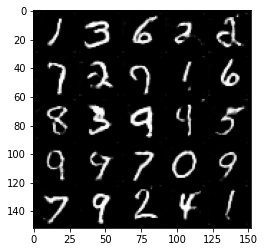

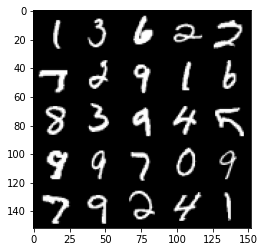

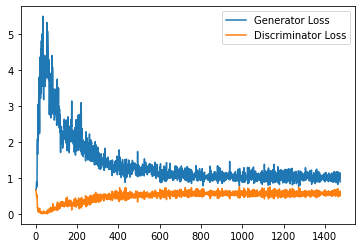

Epoch 63, step 30000: Generator loss: 1.0224236800670623, discriminator loss: 0.5847215647697449


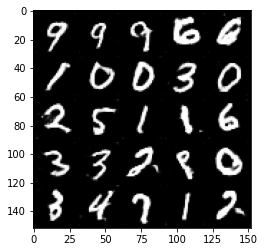

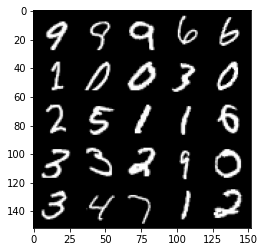

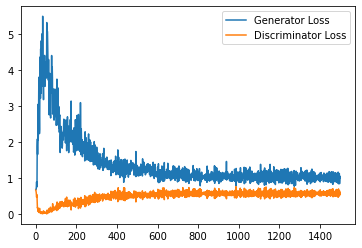

Epoch 65, step 30500: Generator loss: 1.0225780944824219, discriminator loss: 0.5933089297413826


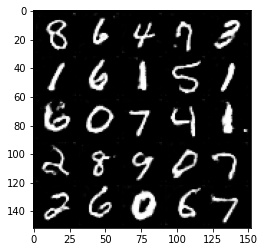

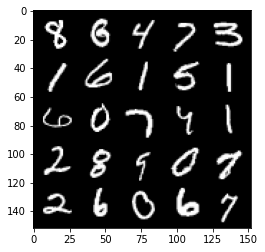

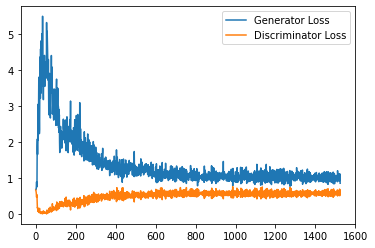

Epoch 66, step 31000: Generator loss: 0.9970226650238037, discriminator loss: 0.5909211289286613


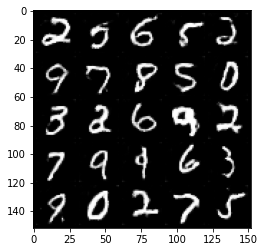

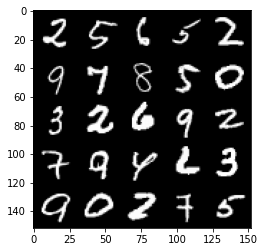

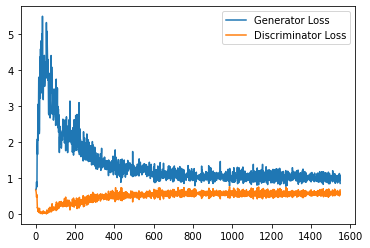

Epoch 67, step 31500: Generator loss: 1.0106928689479828, discriminator loss: 0.5873788331747055


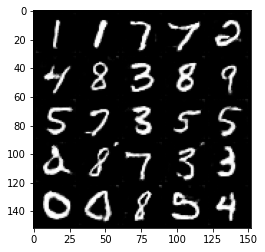

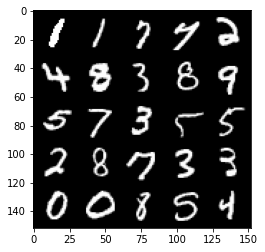

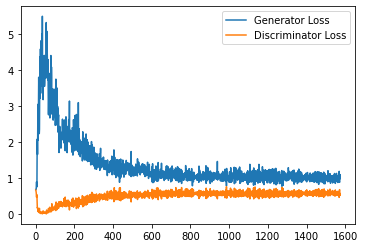

Epoch 68, step 32000: Generator loss: 1.0263635089397432, discriminator loss: 0.588408048570156


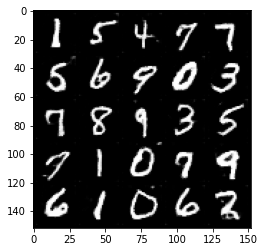

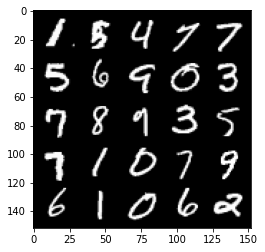

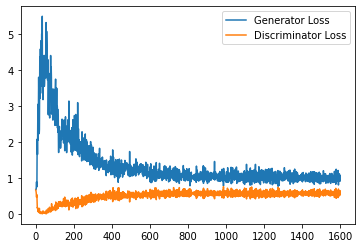

Epoch 69, step 32500: Generator loss: 1.012037871479988, discriminator loss: 0.5981031975150108


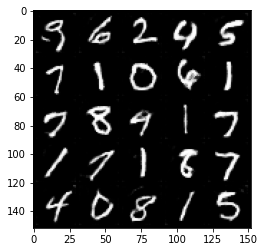

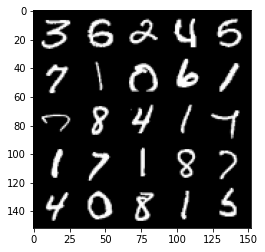

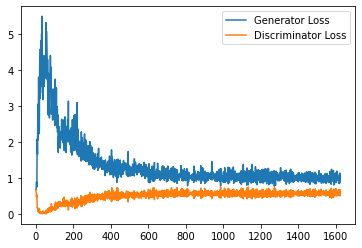

Epoch 70, step 33000: Generator loss: 1.0114128825664521, discriminator loss: 0.5889341541528702


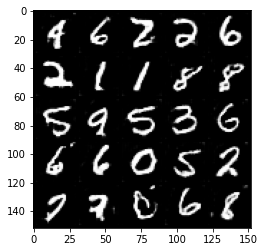

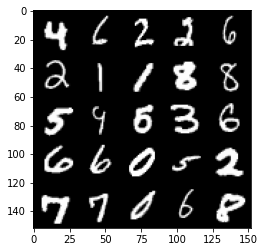

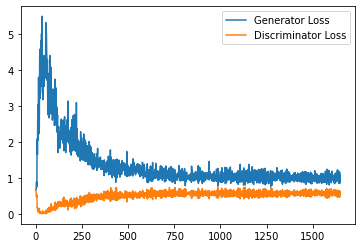

Epoch 71, step 33500: Generator loss: 1.0290266047716141, discriminator loss: 0.5835717461109161


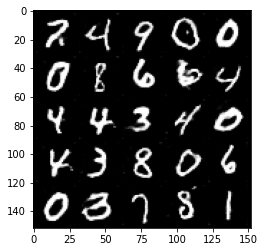

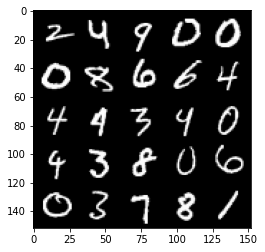

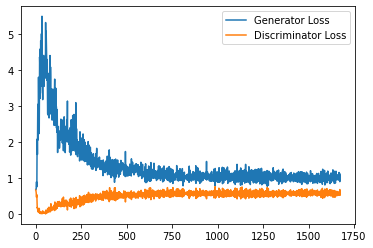

Epoch 72, step 34000: Generator loss: 1.002247375011444, discriminator loss: 0.5921906487941742


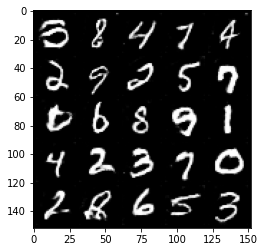

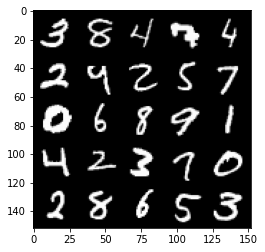

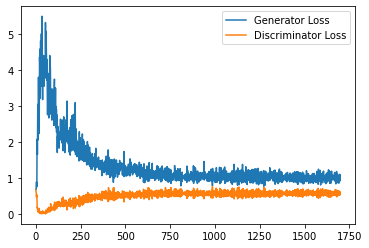

Epoch 73, step 34500: Generator loss: 1.0049448997974395, discriminator loss: 0.5909272321462631


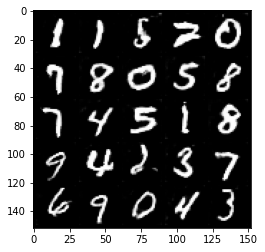

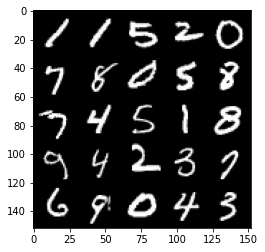

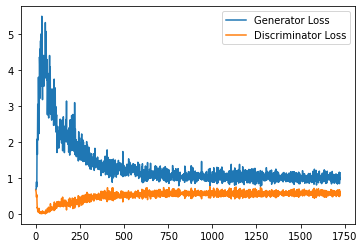

Epoch 74, step 35000: Generator loss: 0.9951126800775528, discriminator loss: 0.5955915279388427


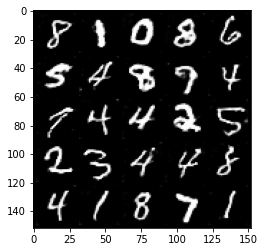

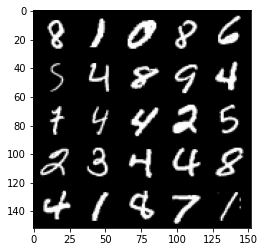

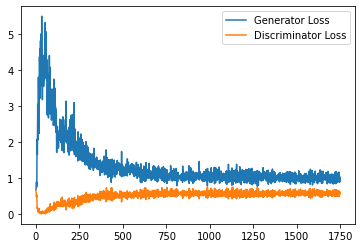

Epoch 75, step 35500: Generator loss: 1.003332956314087, discriminator loss: 0.5948579259514809


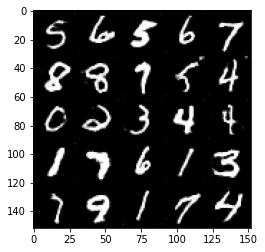

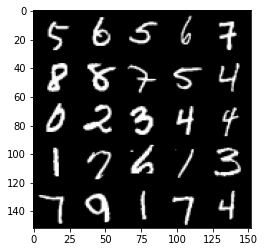

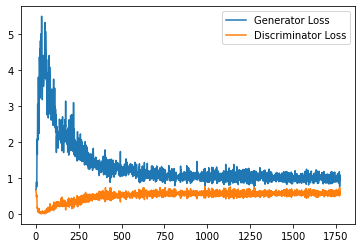

Epoch 76, step 36000: Generator loss: 1.0006053473949432, discriminator loss: 0.5931426062583923


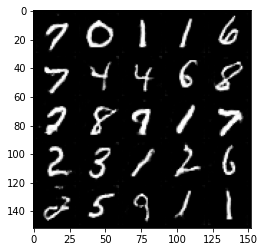

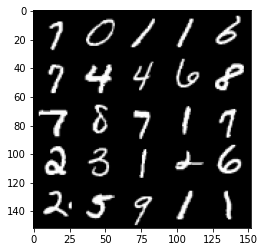

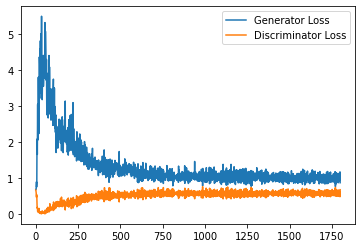

Epoch 77, step 36500: Generator loss: 1.0171303765773774, discriminator loss: 0.590588903605938


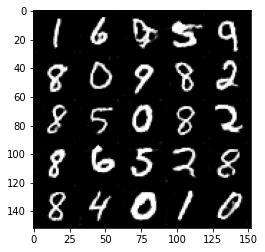

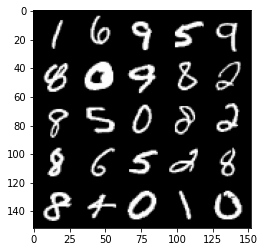

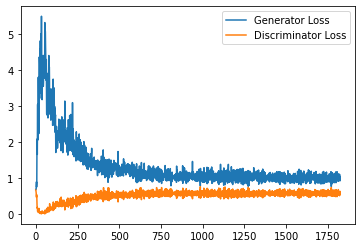

Epoch 78, step 37000: Generator loss: 1.0256714811325074, discriminator loss: 0.5926449446678161


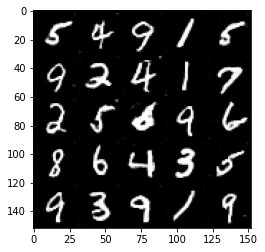

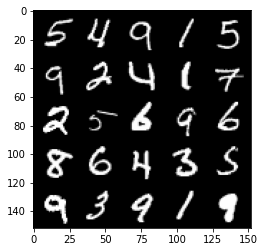

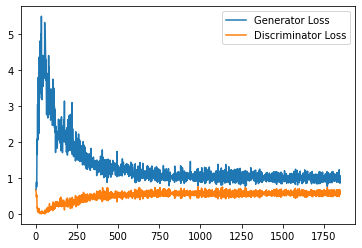

Epoch 79, step 37500: Generator loss: 0.9948333983421326, discriminator loss: 0.5922377027273178


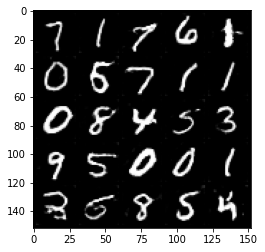

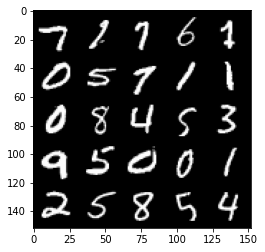

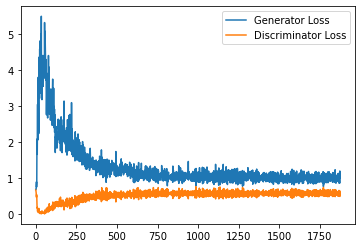

Epoch 81, step 38000: Generator loss: 1.0026104196310044, discriminator loss: 0.5945704573988915


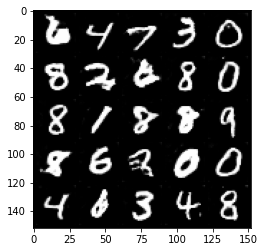

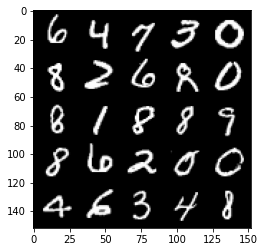

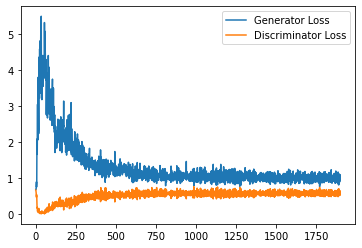

Epoch 82, step 38500: Generator loss: 1.0060359585285186, discriminator loss: 0.5897170974016189


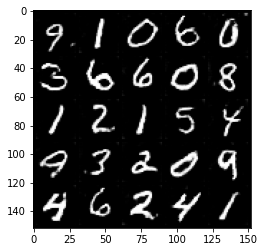

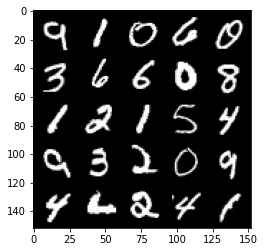

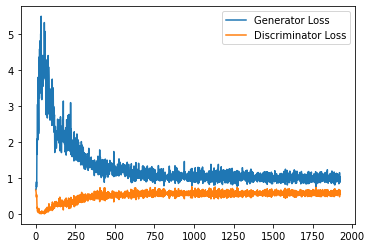

Epoch 83, step 39000: Generator loss: 1.0406784719228745, discriminator loss: 0.5891124021410942


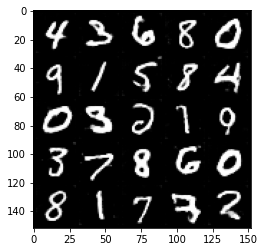

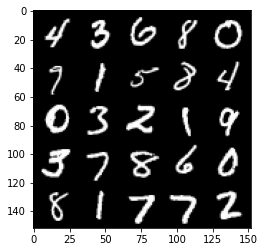

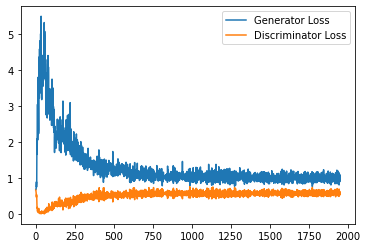

Epoch 84, step 39500: Generator loss: 0.9885942053794861, discriminator loss: 0.5955497782230377


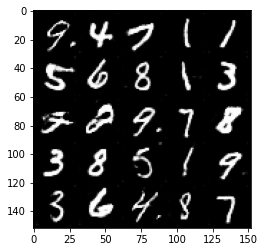

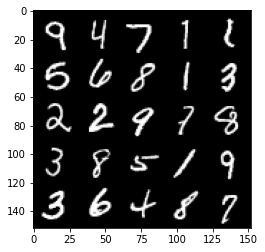

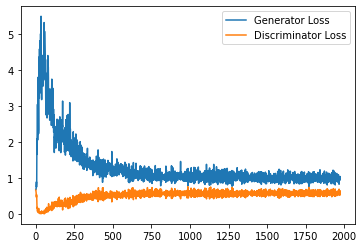

Epoch 85, step 40000: Generator loss: 1.013746773481369, discriminator loss: 0.5910543002486229


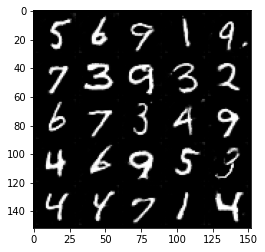

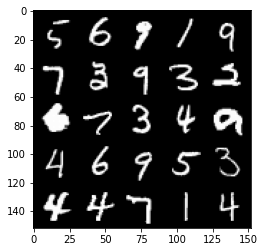

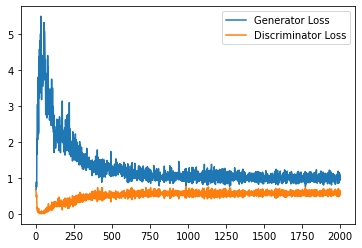

Epoch 86, step 40500: Generator loss: 1.0070593099594116, discriminator loss: 0.5869086297750473


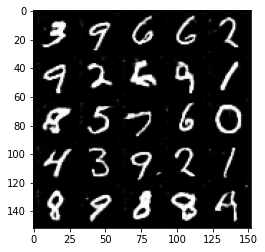

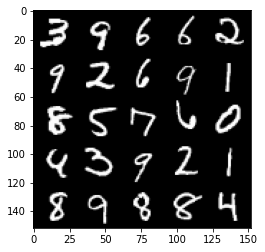

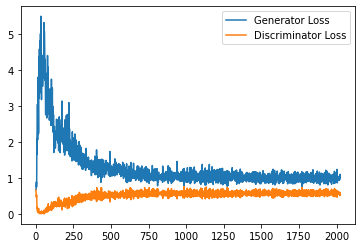

Epoch 87, step 41000: Generator loss: 1.01745168197155, discriminator loss: 0.5921704292893409


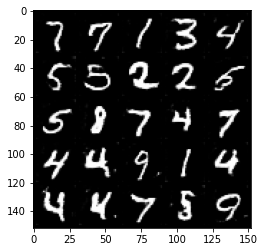

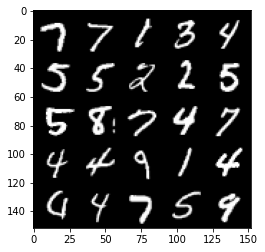

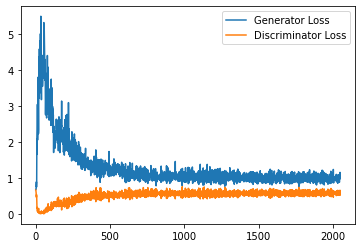

Epoch 88, step 41500: Generator loss: 1.0386582354307174, discriminator loss: 0.5980691082477569


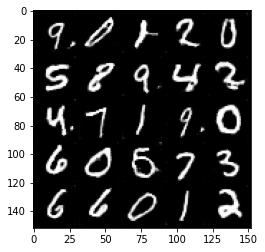

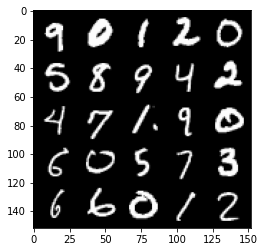

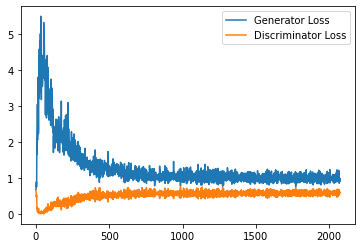

Epoch 89, step 42000: Generator loss: 1.0081081820726394, discriminator loss: 0.5924767597913742


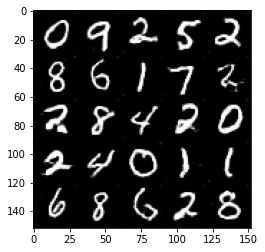

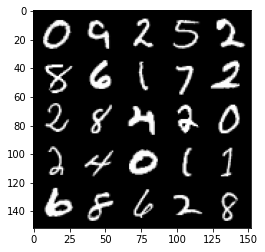

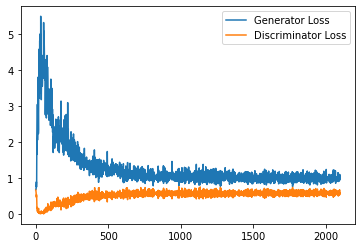

Epoch 90, step 42500: Generator loss: 1.023660473704338, discriminator loss: 0.5890349472165107


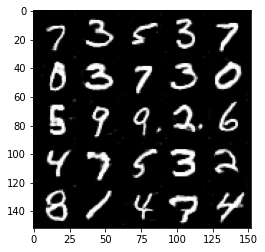

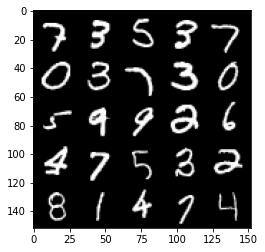

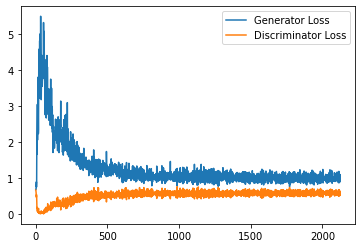

Epoch 91, step 43000: Generator loss: 1.00407883477211, discriminator loss: 0.5933404901623726


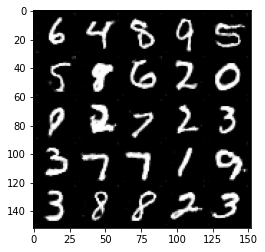

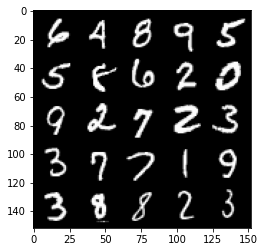

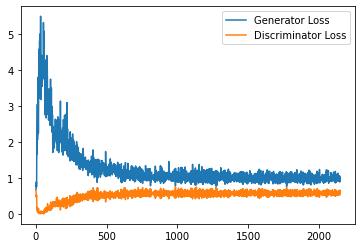

Epoch 92, step 43500: Generator loss: 1.0297303560972213, discriminator loss: 0.5926374521255493


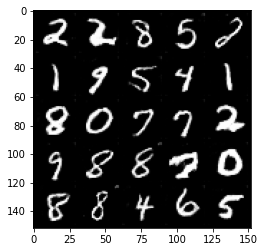

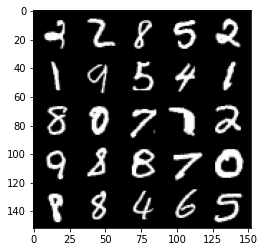

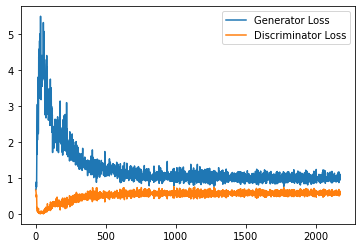

Epoch 93, step 44000: Generator loss: 1.018685161113739, discriminator loss: 0.5975454889535904


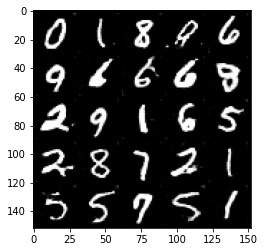

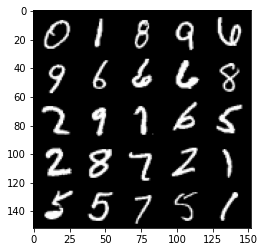

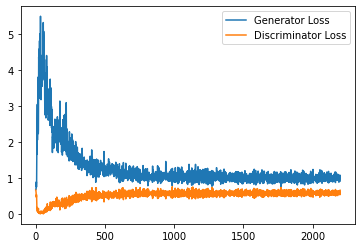

Epoch 94, step 44500: Generator loss: 1.0354183690547942, discriminator loss: 0.5842402491569519


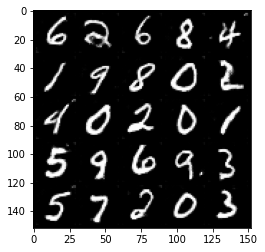

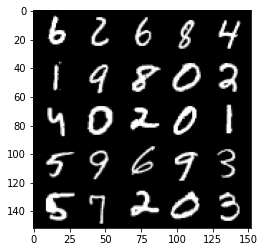

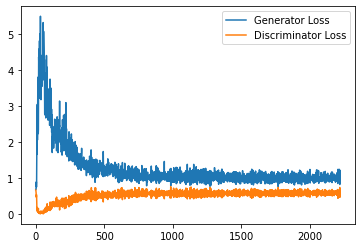

Epoch 95, step 45000: Generator loss: 1.008255960702896, discriminator loss: 0.5872036561369895


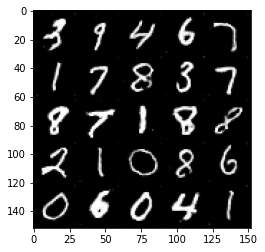

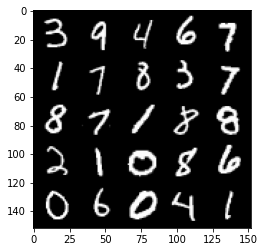

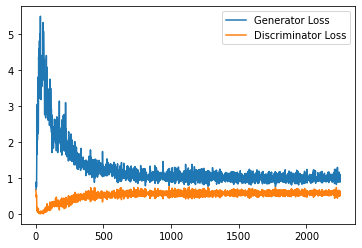

Epoch 97, step 45500: Generator loss: 1.0140986858606338, discriminator loss: 0.5875640882253647


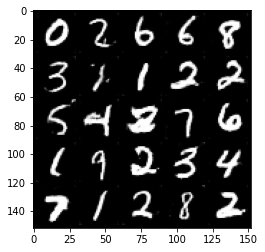

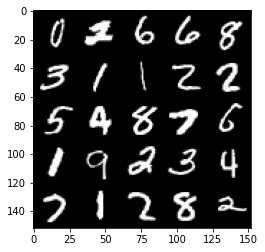

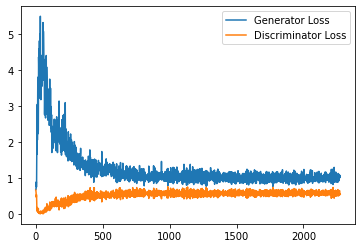

Epoch 98, step 46000: Generator loss: 1.0215617088079452, discriminator loss: 0.5890845182538033


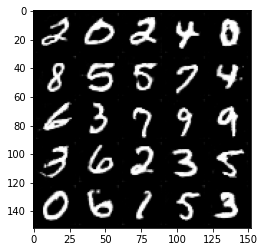

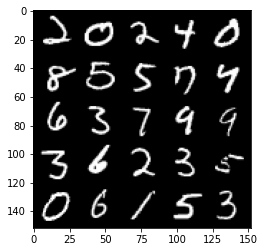

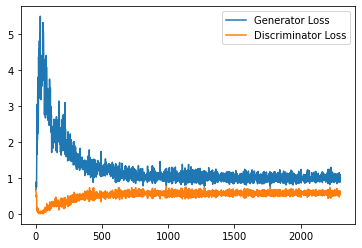

Epoch 99, step 46500: Generator loss: 1.0279802404642104, discriminator loss: 0.5861432957053184


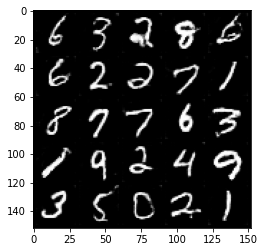

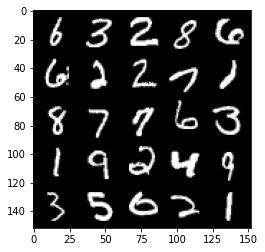

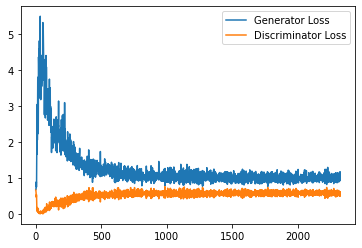

Epoch 100, step 47000: Generator loss: 1.005756800055504, discriminator loss: 0.5899207466840743


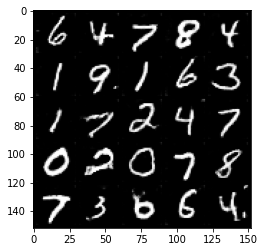

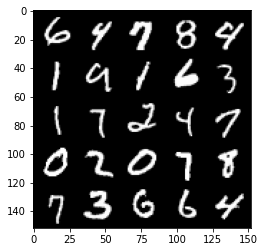

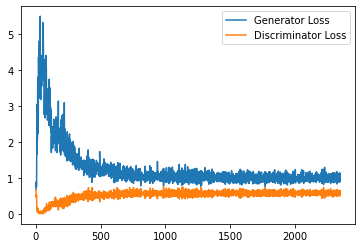

Epoch 101, step 47500: Generator loss: 1.0169275970458984, discriminator loss: 0.584068148970604


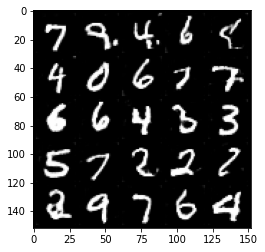

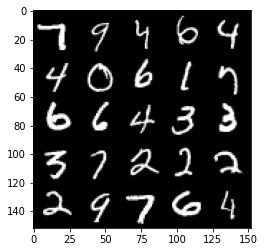

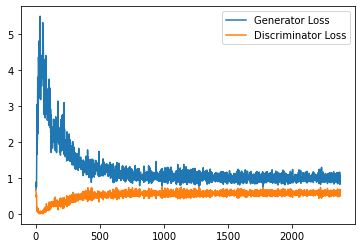

Epoch 102, step 48000: Generator loss: 1.0361472764015198, discriminator loss: 0.5901624756455421


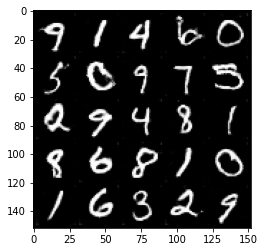

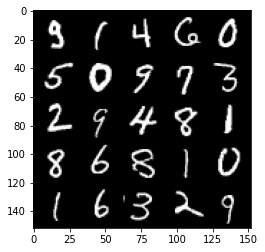

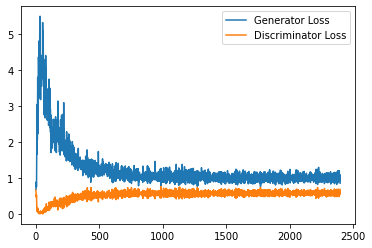

Epoch 103, step 48500: Generator loss: 1.0623394142389297, discriminator loss: 0.5809579575657845


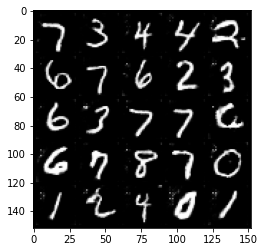

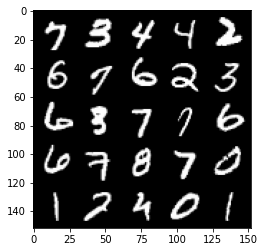

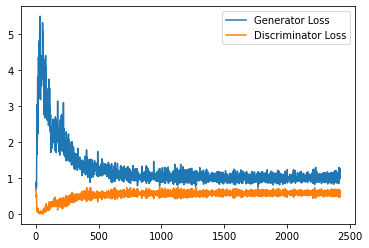

Epoch 104, step 49000: Generator loss: 1.0251636986732482, discriminator loss: 0.5791158437728882


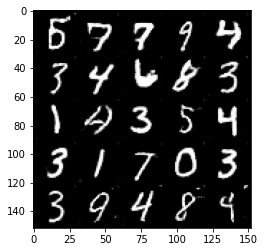

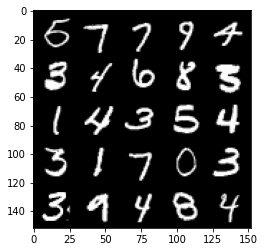

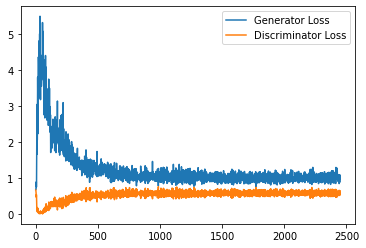

Epoch 105, step 49500: Generator loss: 1.0265154694318772, discriminator loss: 0.5826878152489662


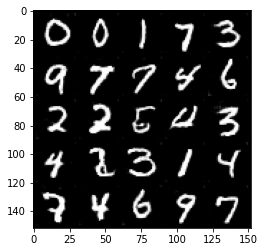

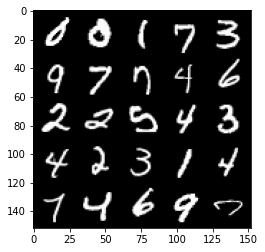

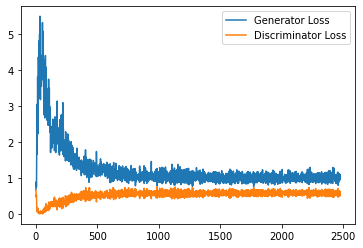

Epoch 106, step 50000: Generator loss: 1.0293109438419341, discriminator loss: 0.5840135342478752


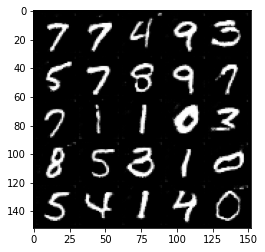

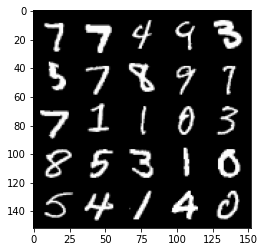

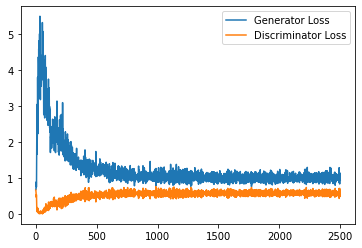

Epoch 107, step 50500: Generator loss: 1.0202271742820739, discriminator loss: 0.5830486326813697


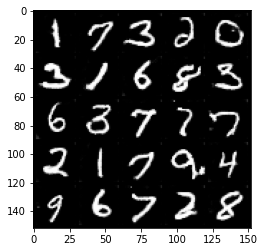

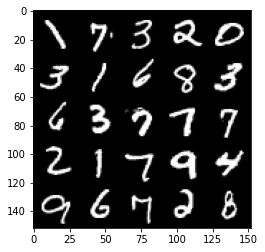

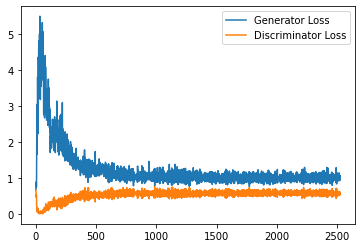

Epoch 108, step 51000: Generator loss: 1.0354179207086562, discriminator loss: 0.5789530076384545


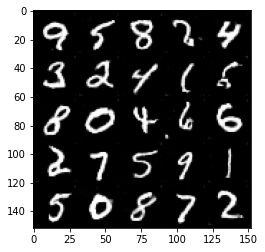

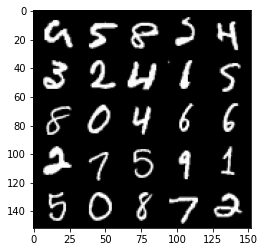

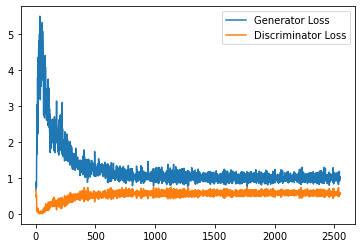

Epoch 109, step 51500: Generator loss: 1.0423593072891235, discriminator loss: 0.5804409304857254


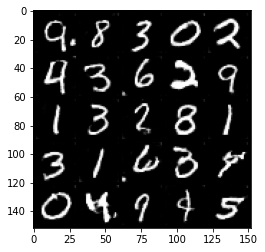

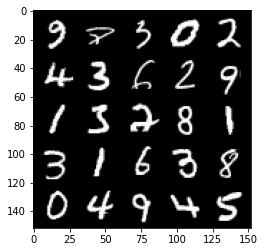

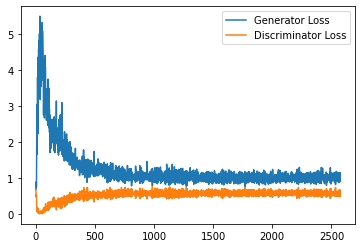

Epoch 110, step 52000: Generator loss: 1.0556417407989502, discriminator loss: 0.5784770998954772


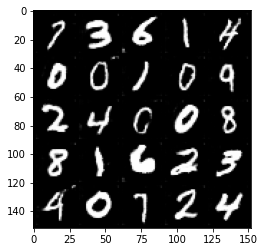

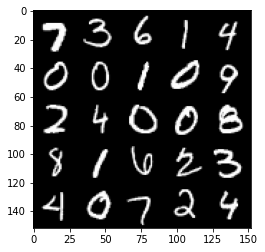

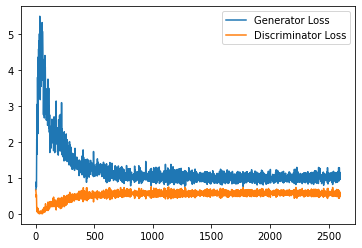

Epoch 111, step 52500: Generator loss: 1.0133802909851075, discriminator loss: 0.575781607747078


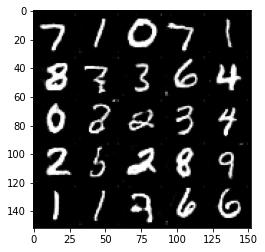

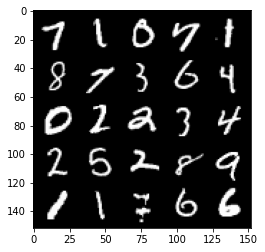

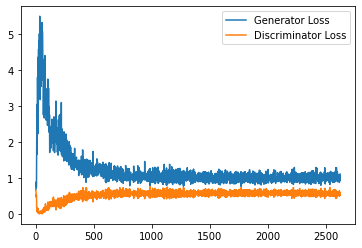

Epoch 113, step 53000: Generator loss: 1.0365107675790788, discriminator loss: 0.5801349746584892


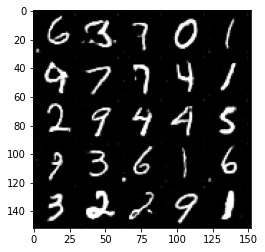

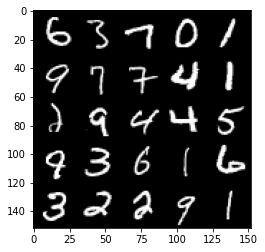

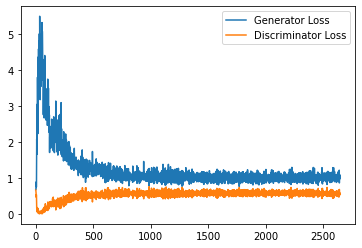

Epoch 114, step 53500: Generator loss: 1.0495269402265548, discriminator loss: 0.5755977093577385


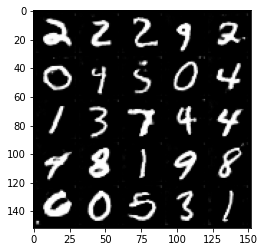

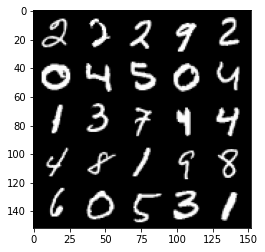

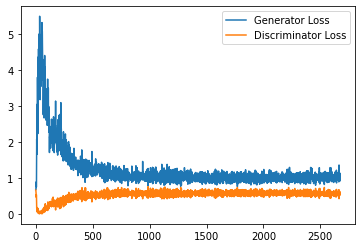

Epoch 115, step 54000: Generator loss: 1.0185438071489334, discriminator loss: 0.57829050552845


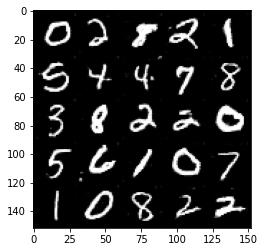

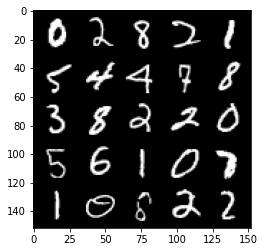

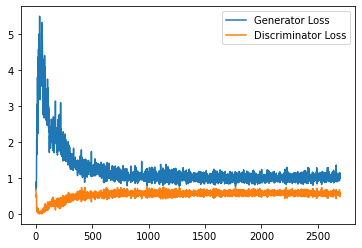

Epoch 116, step 54500: Generator loss: 1.0503397308588027, discriminator loss: 0.5702940669059754


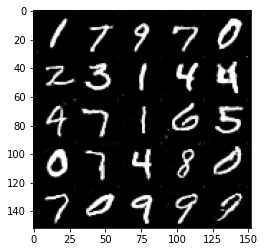

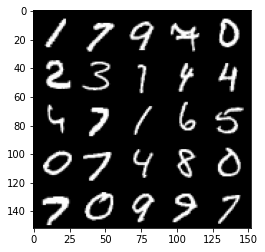

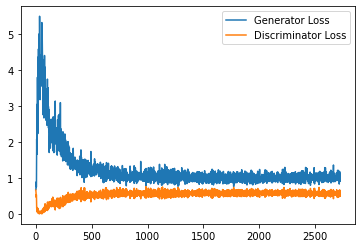

Epoch 117, step 55000: Generator loss: 1.0387114996910096, discriminator loss: 0.5750351792573929


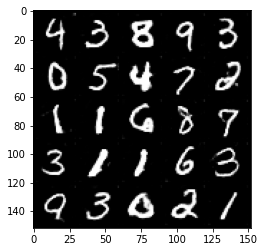

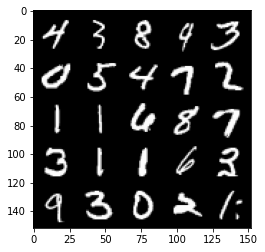

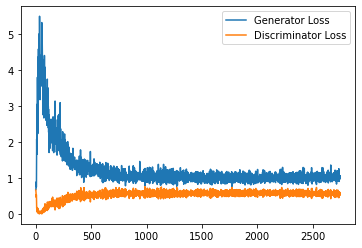

Epoch 118, step 55500: Generator loss: 1.036275416970253, discriminator loss: 0.5760247035622597


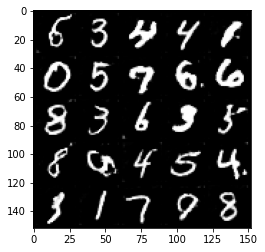

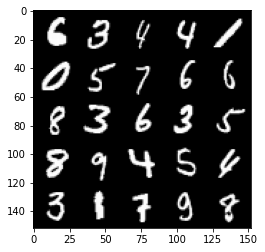

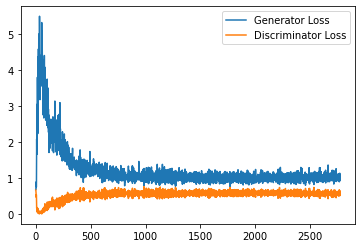

Epoch 119, step 56000: Generator loss: 1.04400687623024, discriminator loss: 0.5756689782738685


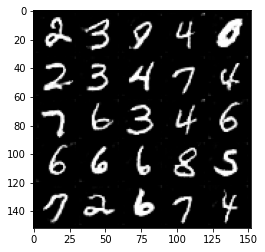

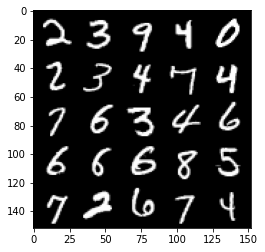

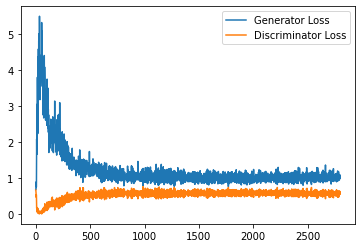

Epoch 120, step 56500: Generator loss: 1.074112069606781, discriminator loss: 0.572064678132534


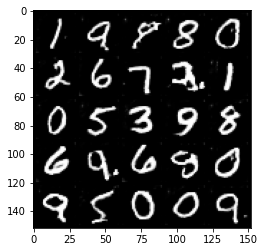

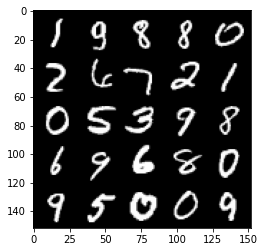

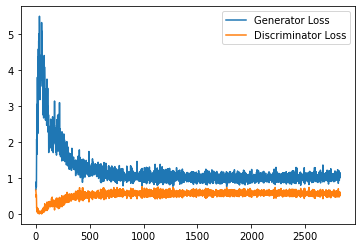

Epoch 121, step 57000: Generator loss: 1.0496912404298782, discriminator loss: 0.5748771041631698


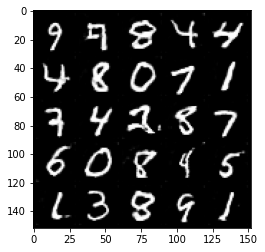

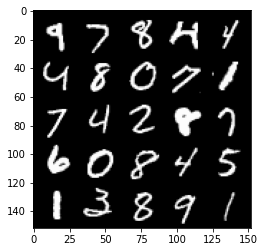

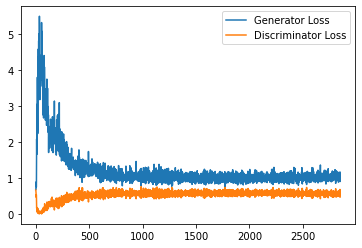

Epoch 122, step 57500: Generator loss: 1.0496973884105683, discriminator loss: 0.5793092584609986


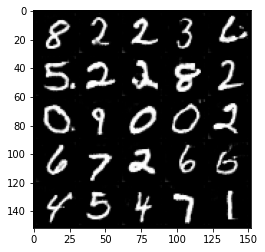

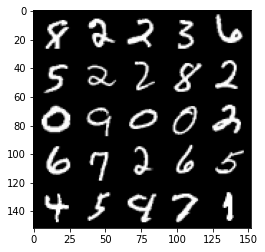

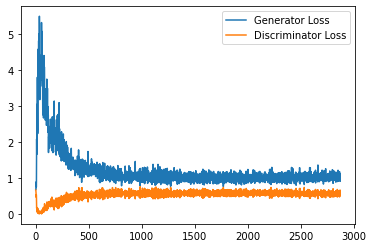

Epoch 123, step 58000: Generator loss: 1.0337136272192002, discriminator loss: 0.5719992498755455


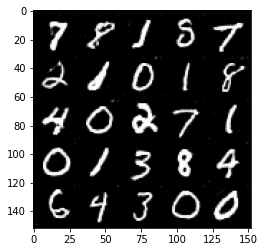

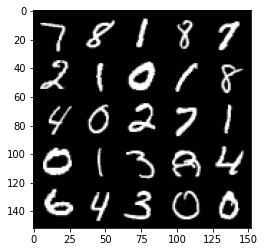

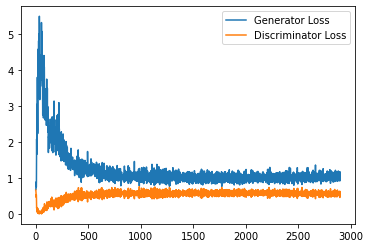

Epoch 124, step 58500: Generator loss: 1.0567697833776475, discriminator loss: 0.5707617620229721


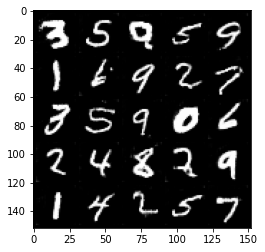

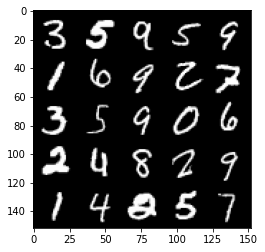

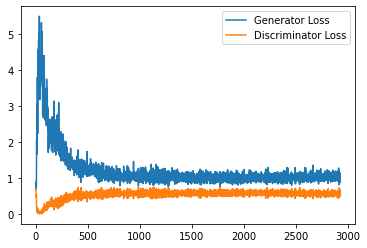

Epoch 125, step 59000: Generator loss: 1.0737037252187729, discriminator loss: 0.5686987665891647


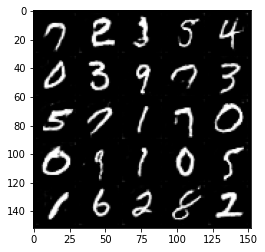

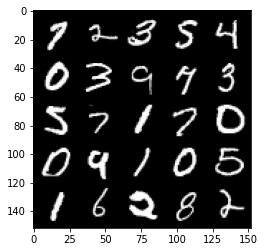

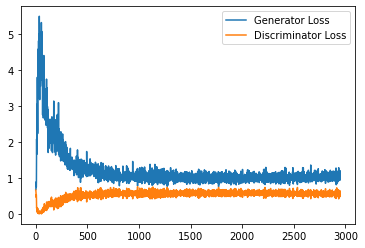

Epoch 126, step 59500: Generator loss: 1.0541618387699128, discriminator loss: 0.5744274506568908


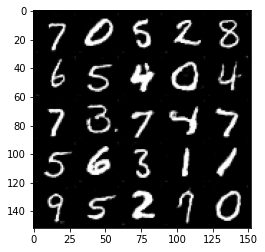

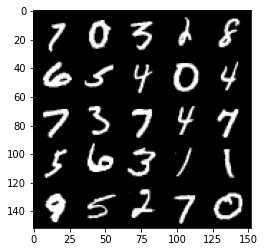

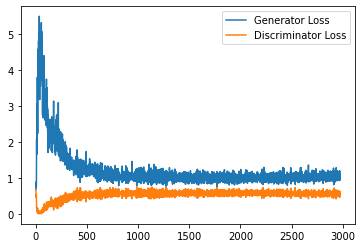

Epoch 127, step 60000: Generator loss: 1.0672586830854416, discriminator loss: 0.5742162179350853


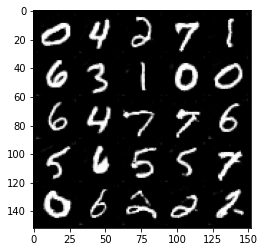

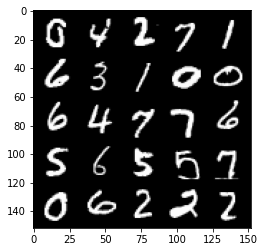

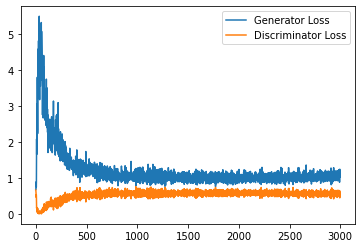

Epoch 128, step 60500: Generator loss: 1.0498400300741195, discriminator loss: 0.5729564762115479


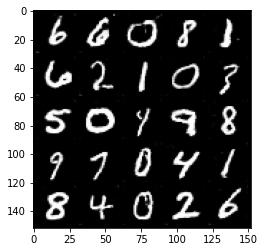

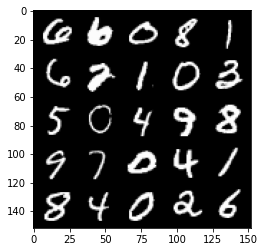

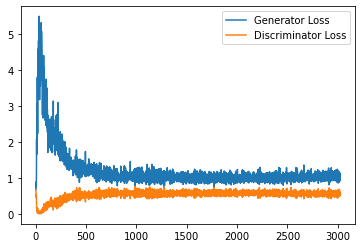

Epoch 130, step 61000: Generator loss: 1.0400888214111328, discriminator loss: 0.5716552079916001


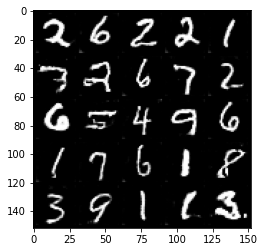

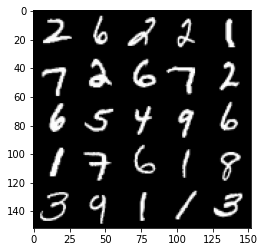

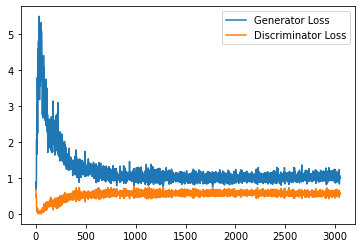

Epoch 131, step 61500: Generator loss: 1.0735174989700318, discriminator loss: 0.5708319674730301


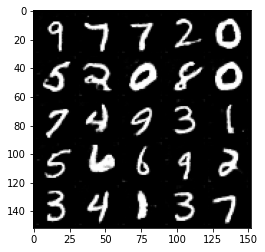

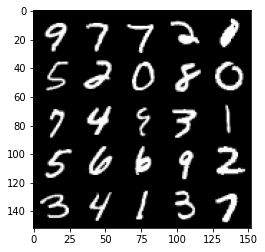

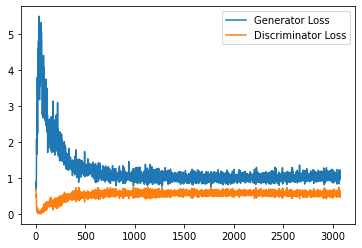

Epoch 132, step 62000: Generator loss: 1.0672890000343322, discriminator loss: 0.5791154845356942


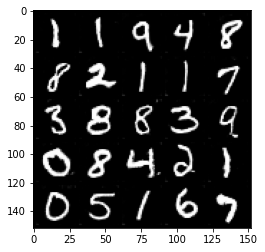

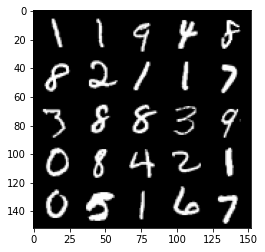

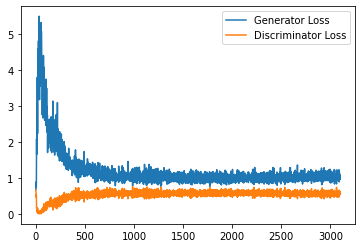

Epoch 133, step 62500: Generator loss: 1.0593960177898407, discriminator loss: 0.5706504570841789


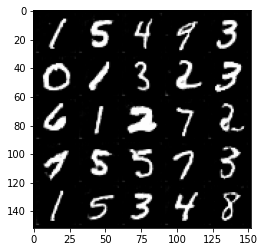

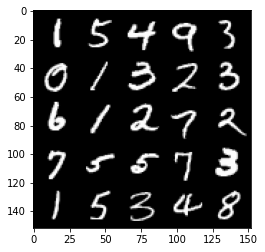

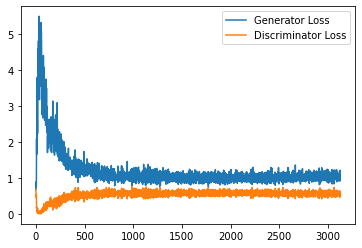

Epoch 134, step 63000: Generator loss: 1.0749711903333663, discriminator loss: 0.5728295106887817


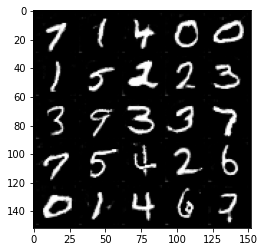

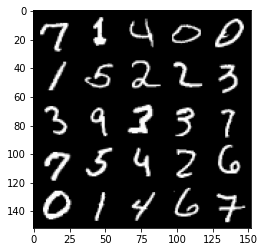

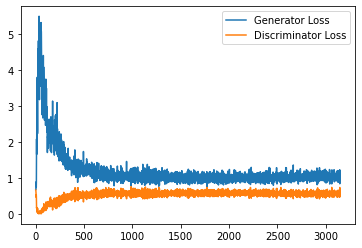

Epoch 135, step 63500: Generator loss: 1.0645865131616592, discriminator loss: 0.5770108928084373


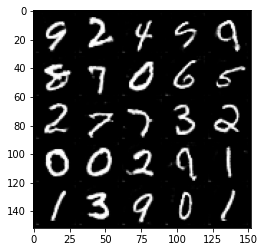

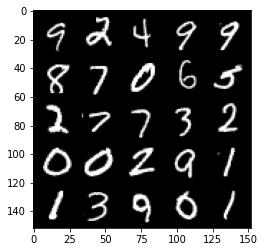

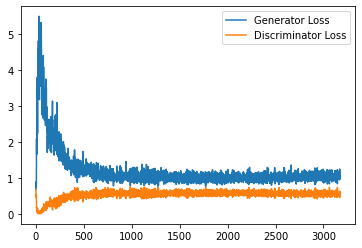

Epoch 136, step 64000: Generator loss: 1.0623429851531982, discriminator loss: 0.5654523965716362


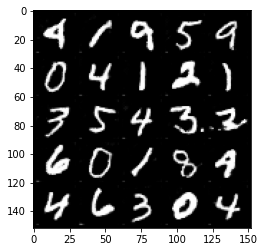

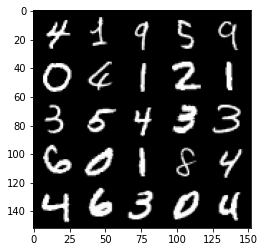

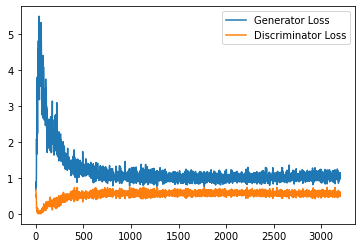

Epoch 137, step 64500: Generator loss: 1.0601724178791045, discriminator loss: 0.5742276329994201


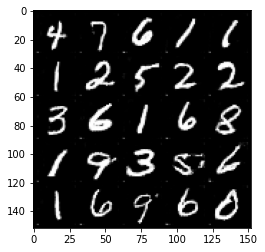

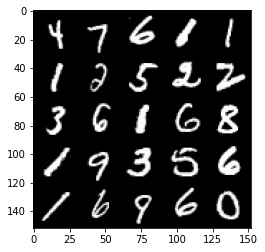

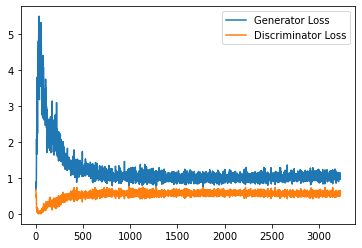

Epoch 138, step 65000: Generator loss: 1.078779650092125, discriminator loss: 0.5710373277068138


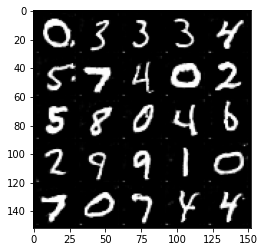

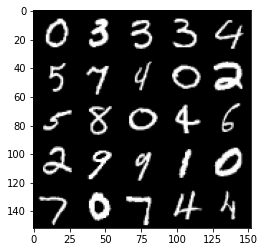

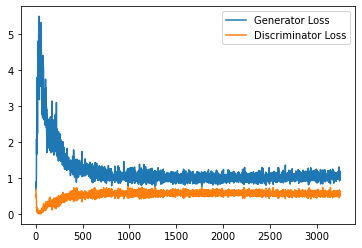

Epoch 139, step 65500: Generator loss: 1.057127501487732, discriminator loss: 0.5761676529645919


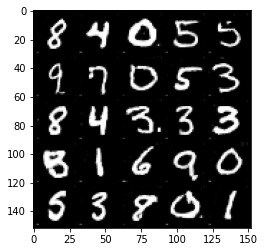

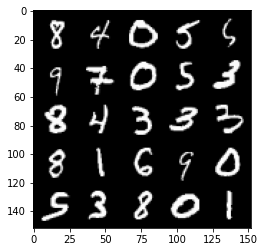

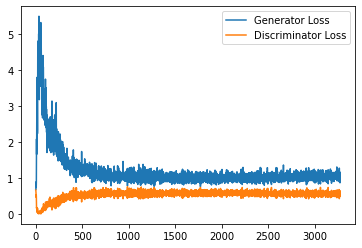

Epoch 140, step 66000: Generator loss: 1.059086522102356, discriminator loss: 0.5713183346390724


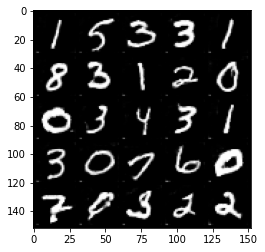

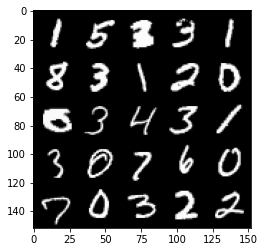

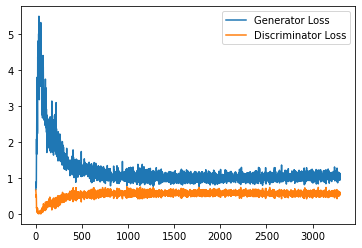

Epoch 141, step 66500: Generator loss: 1.05161224257946, discriminator loss: 0.5786496733427048


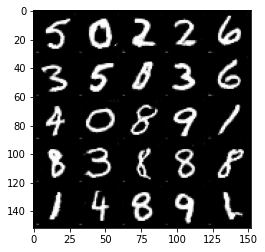

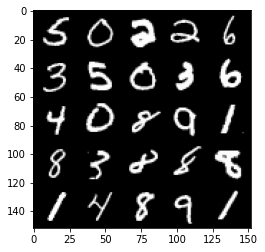

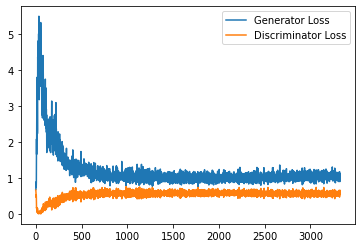

Epoch 142, step 67000: Generator loss: 1.0714654467105866, discriminator loss: 0.5690990934371948


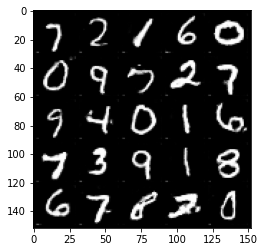

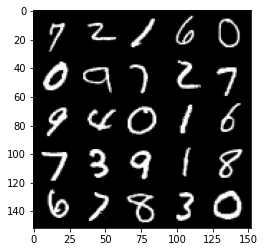

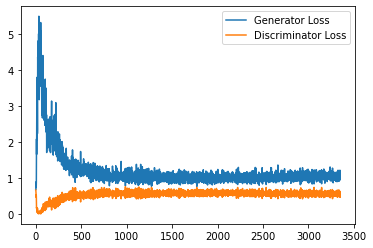

Epoch 143, step 67500: Generator loss: 1.0584492907524108, discriminator loss: 0.5728040109276772


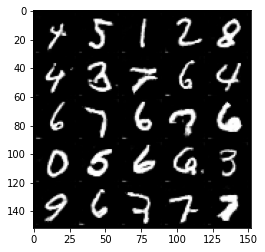

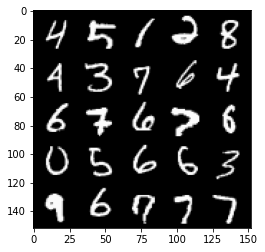

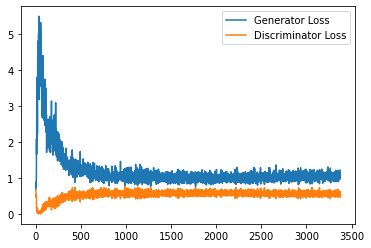

Epoch 144, step 68000: Generator loss: 1.0430773986577988, discriminator loss: 0.5757378388047218


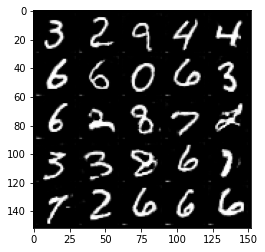

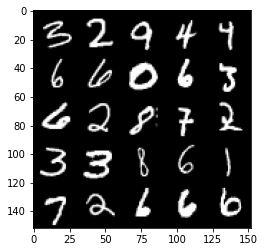

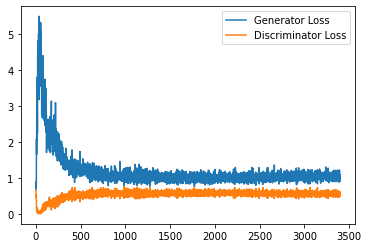

Epoch 146, step 68500: Generator loss: 1.0488549488782883, discriminator loss: 0.5756978231072426


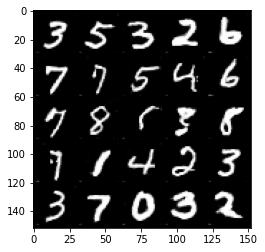

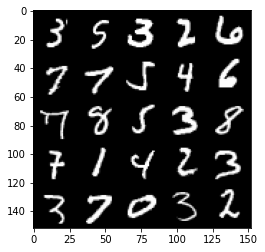

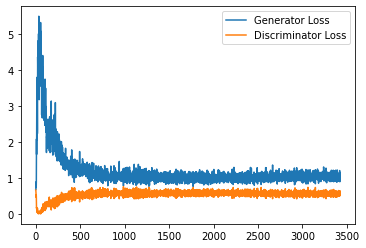

Epoch 147, step 69000: Generator loss: 1.040822061061859, discriminator loss: 0.5748663418889046


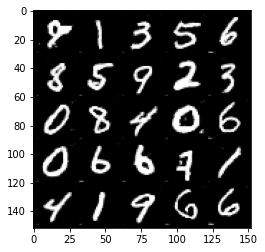

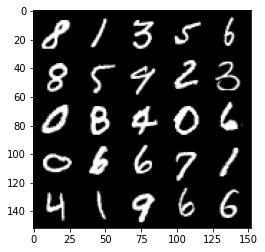

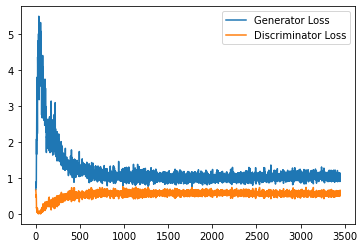

Epoch 148, step 69500: Generator loss: 1.0851041600704192, discriminator loss: 0.5689453839063644


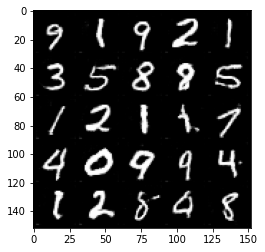

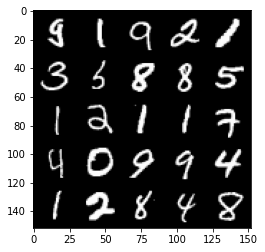

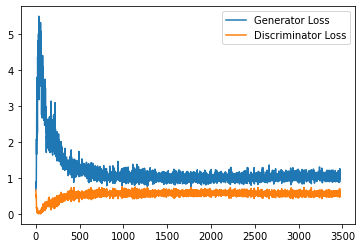

Epoch 149, step 70000: Generator loss: 1.073437858223915, discriminator loss: 0.5719995064735413


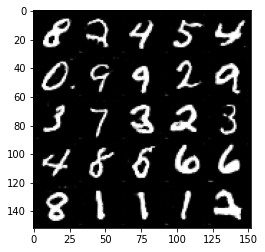

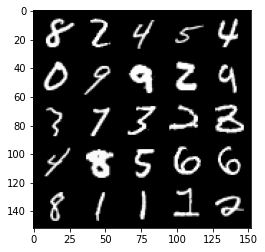

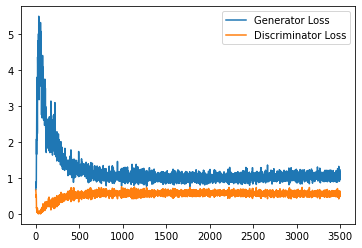

Epoch 150, step 70500: Generator loss: 1.0652599568367005, discriminator loss: 0.5720464525818825


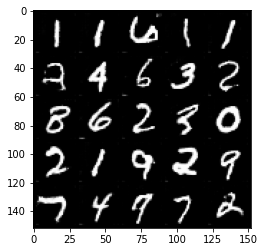

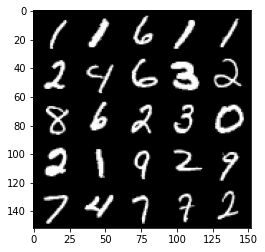

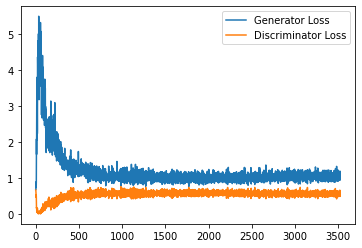

Epoch 151, step 71000: Generator loss: 1.0821344698667525, discriminator loss: 0.5787814444899559


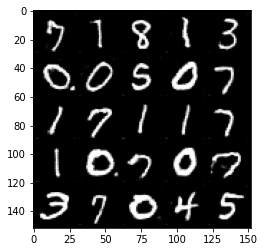

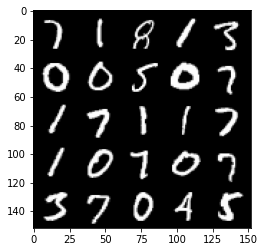

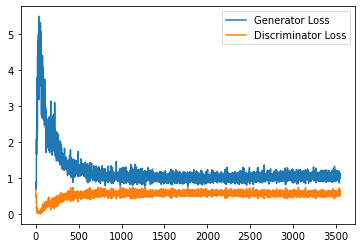

Epoch 152, step 71500: Generator loss: 1.0705589243173599, discriminator loss: 0.5725404108762742


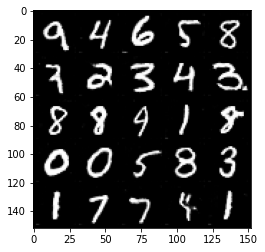

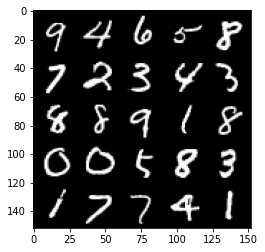

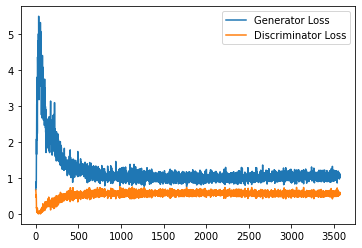

Epoch 153, step 72000: Generator loss: 1.0710014600753783, discriminator loss: 0.5747267464995385


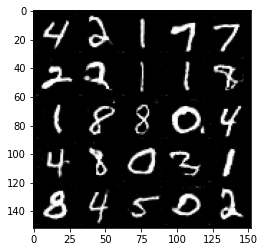

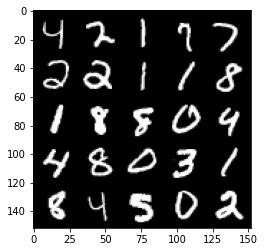

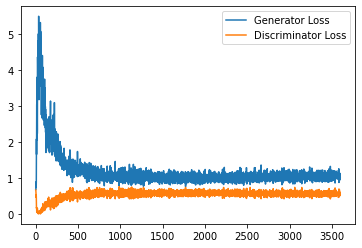

Epoch 154, step 72500: Generator loss: 1.0621352835893632, discriminator loss: 0.574807481765747


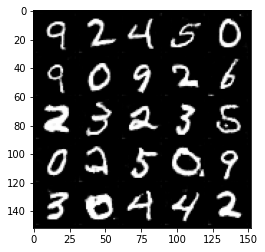

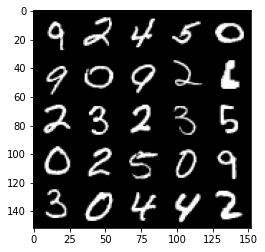

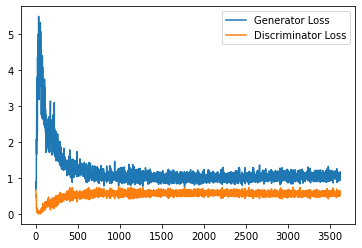

Epoch 155, step 73000: Generator loss: 1.0622098851203918, discriminator loss: 0.576663309454918


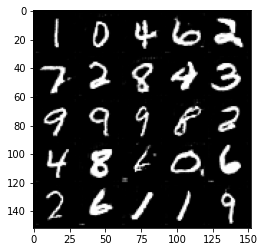

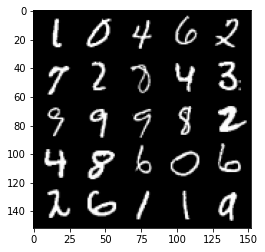

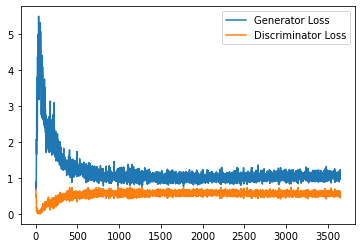

Epoch 156, step 73500: Generator loss: 1.0750466910600662, discriminator loss: 0.5727360121607781


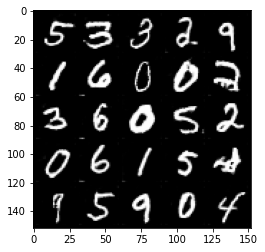

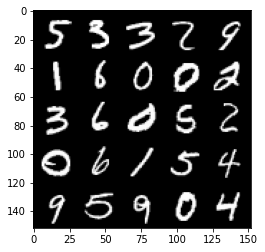

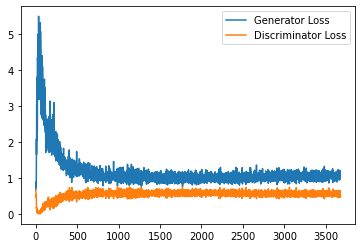

Epoch 157, step 74000: Generator loss: 1.0487673670053481, discriminator loss: 0.5779302944540977


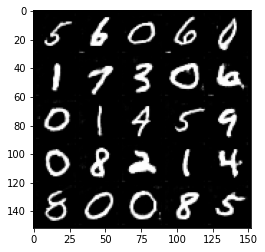

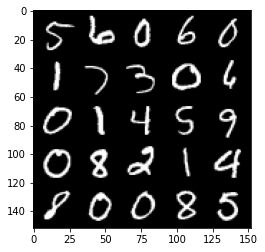

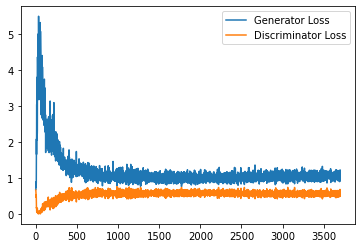

Epoch 158, step 74500: Generator loss: 1.0465154201984406, discriminator loss: 0.5785026343464852


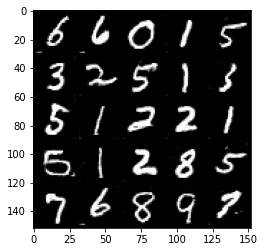

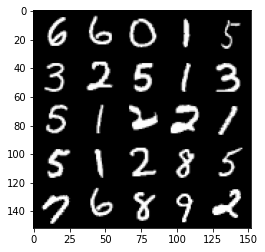

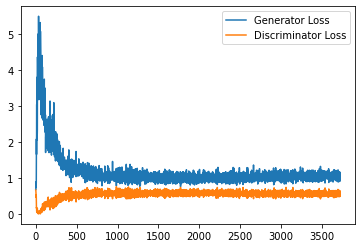

Epoch 159, step 75000: Generator loss: 1.0584707208871842, discriminator loss: 0.5760839394330979


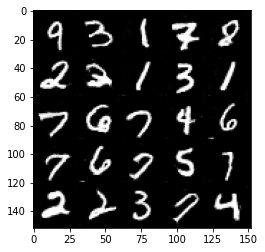

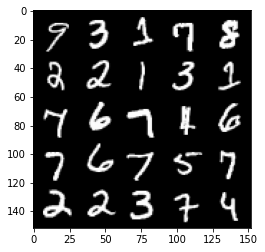

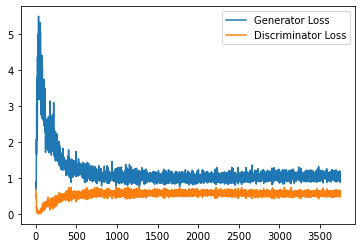

Epoch 160, step 75500: Generator loss: 1.052487091064453, discriminator loss: 0.5753786553740501


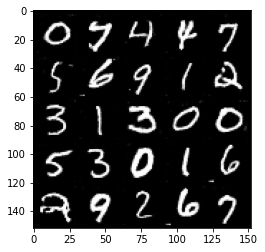

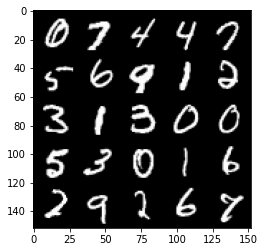

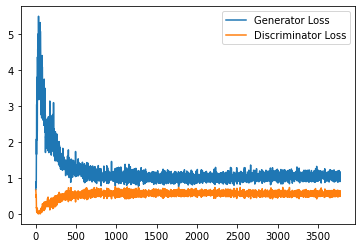

Epoch 162, step 76000: Generator loss: 1.0726049095392227, discriminator loss: 0.5797188650965691


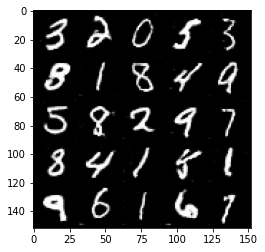

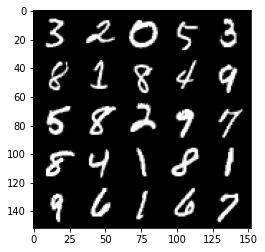

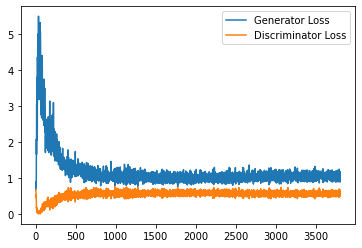

Epoch 163, step 76500: Generator loss: 1.060465715289116, discriminator loss: 0.5765201358795166


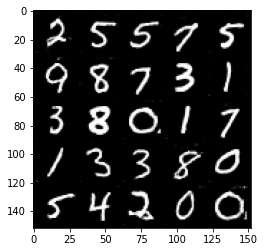

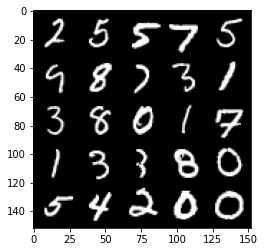

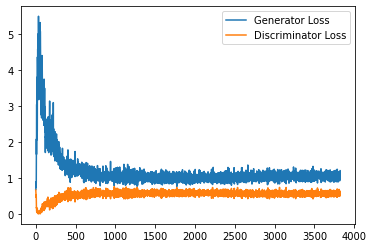

Epoch 164, step 77000: Generator loss: 1.0510223922729491, discriminator loss: 0.5767836636304855


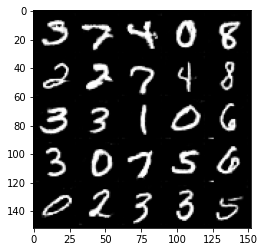

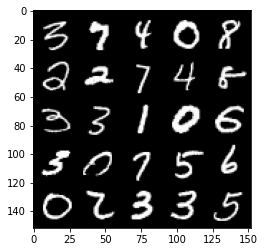

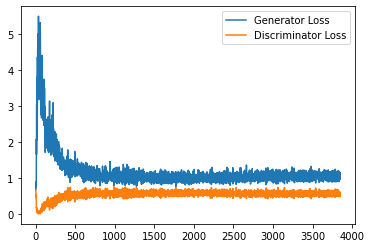

Epoch 165, step 77500: Generator loss: 1.0801211403608322, discriminator loss: 0.5754725035429001


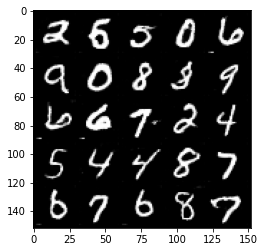

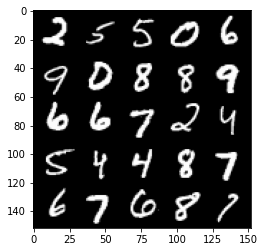

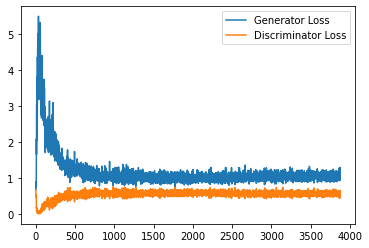

Epoch 166, step 78000: Generator loss: 1.0498484007120132, discriminator loss: 0.576150907933712


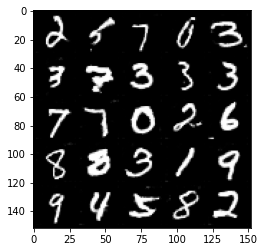

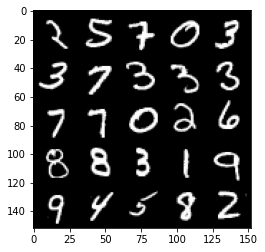

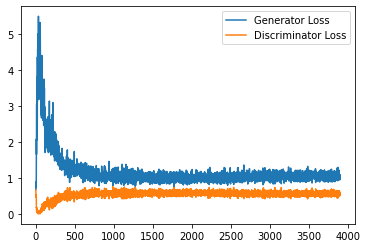

Epoch 167, step 78500: Generator loss: 1.0465472575426102, discriminator loss: 0.5750434840321541


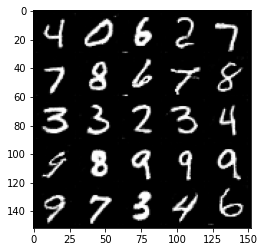

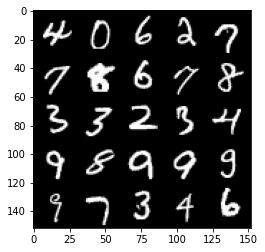

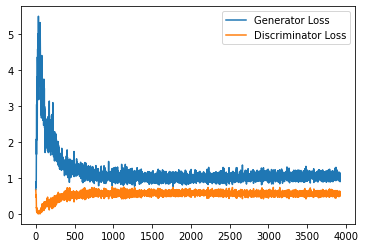

Epoch 168, step 79000: Generator loss: 1.0555414447784424, discriminator loss: 0.5686033057570458


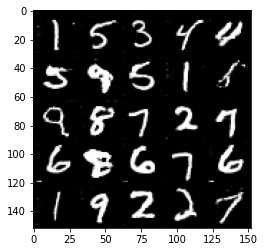

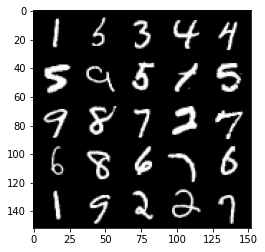

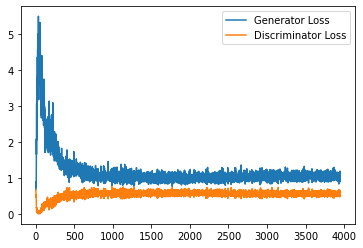

Epoch 169, step 79500: Generator loss: 1.0555294425487518, discriminator loss: 0.5844784771800041


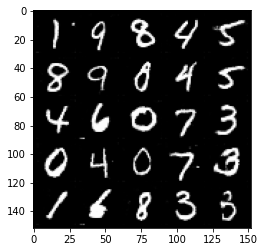

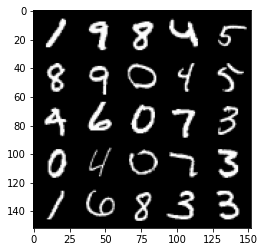

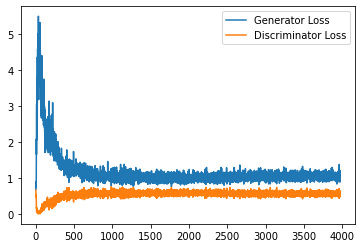

Epoch 170, step 80000: Generator loss: 1.0645704535245895, discriminator loss: 0.5812955281734467


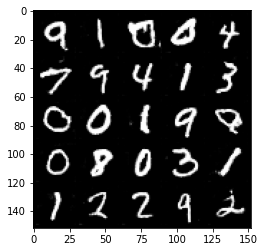

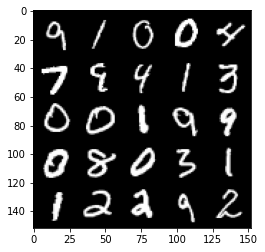

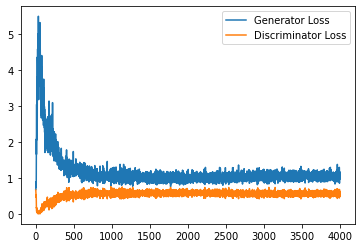

Epoch 171, step 80500: Generator loss: 1.0688116147518159, discriminator loss: 0.5766646944284439


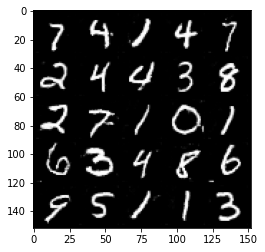

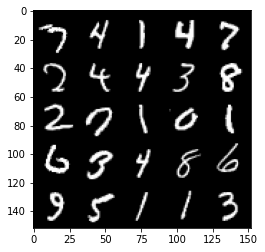

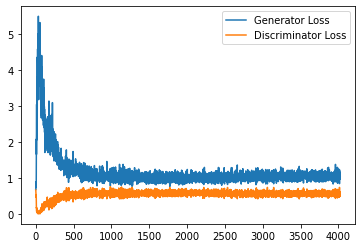

Epoch 172, step 81000: Generator loss: 1.0436877027750016, discriminator loss: 0.5737039918899536


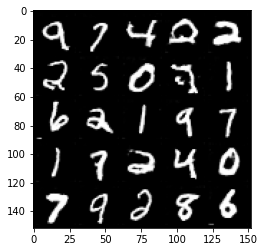

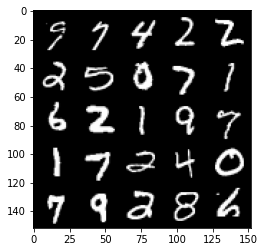

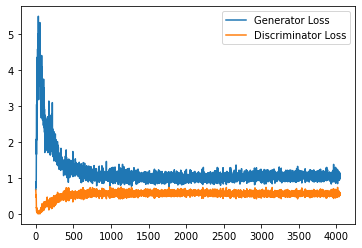

Epoch 173, step 81500: Generator loss: 1.0533162420988083, discriminator loss: 0.5750737124085427


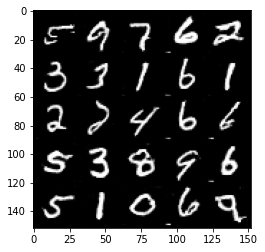

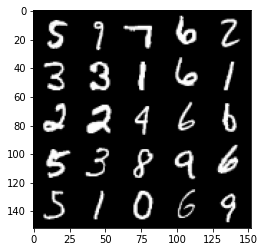

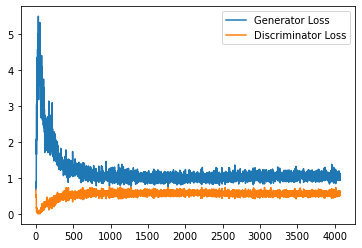

Epoch 174, step 82000: Generator loss: 1.062547766685486, discriminator loss: 0.5783590372204781


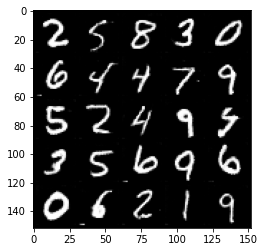

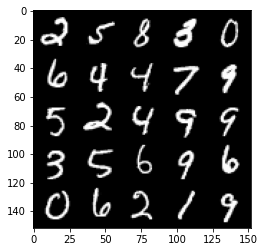

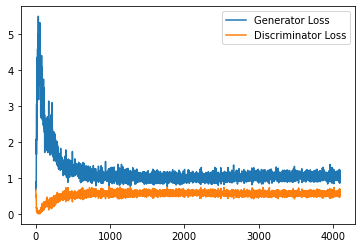

Epoch 175, step 82500: Generator loss: 1.0697069090604783, discriminator loss: 0.572644471347332


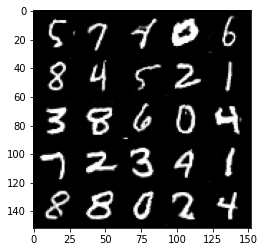

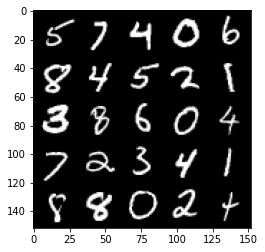

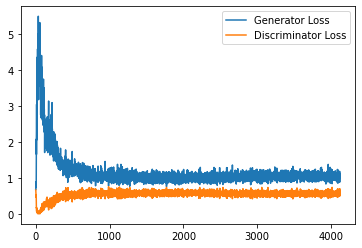

Epoch 176, step 83000: Generator loss: 1.0577565014362336, discriminator loss: 0.5756348506808281


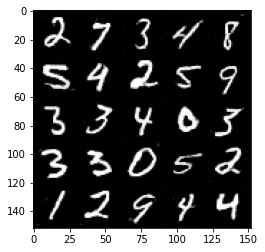

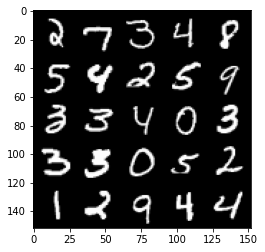

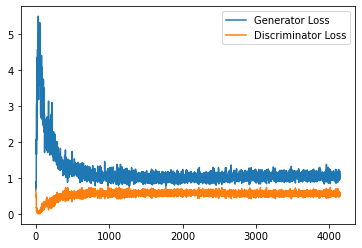

Epoch 178, step 83500: Generator loss: 1.0679658722877503, discriminator loss: 0.5724606463909149


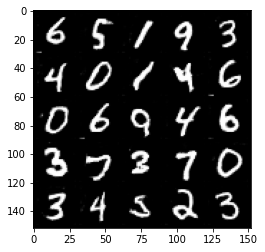

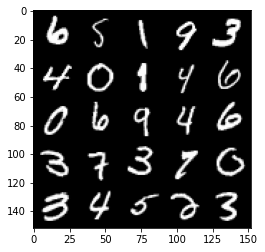

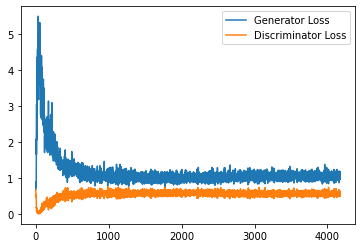

Epoch 179, step 84000: Generator loss: 1.0706242370605468, discriminator loss: 0.5718028229475022


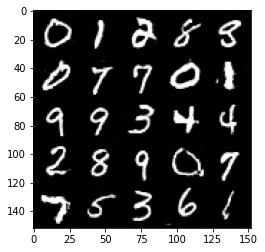

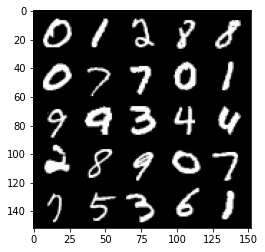

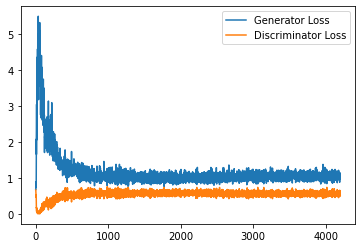

Epoch 180, step 84500: Generator loss: 1.073602175474167, discriminator loss: 0.5753512725234031


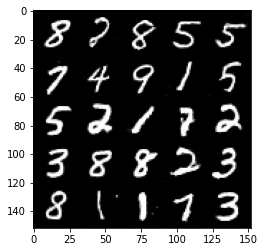

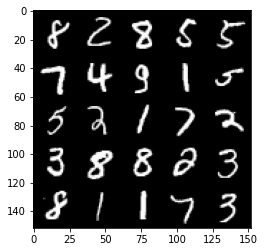

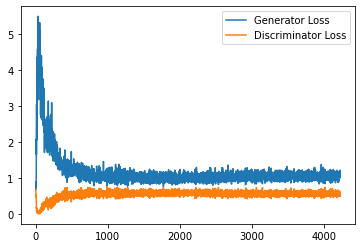

Epoch 181, step 85000: Generator loss: 1.0655197250843047, discriminator loss: 0.5758089954853058


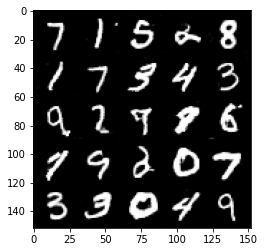

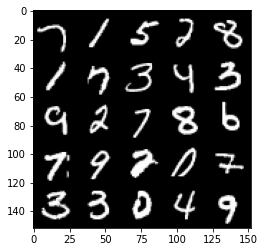

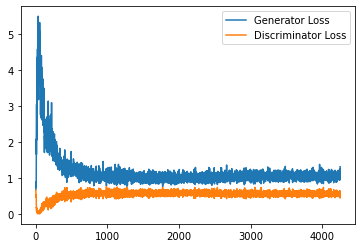

Epoch 182, step 85500: Generator loss: 1.0682338737249375, discriminator loss: 0.5827581857442856


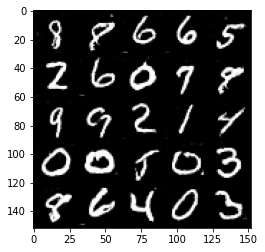

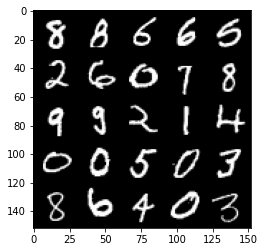

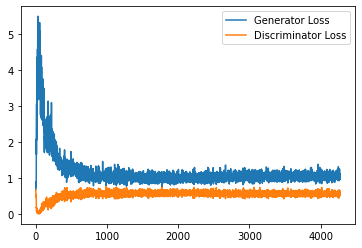

Epoch 183, step 86000: Generator loss: 1.0635805386304855, discriminator loss: 0.5763100348711013


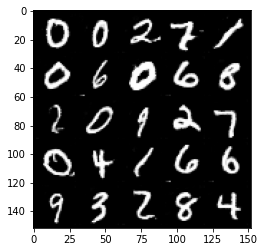

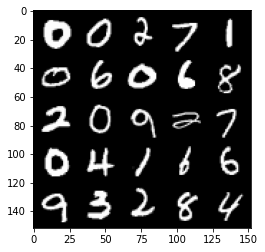

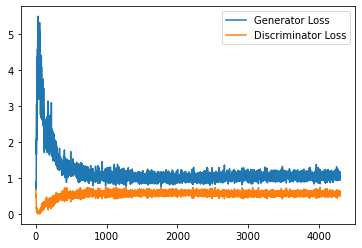

Epoch 184, step 86500: Generator loss: 1.0619043349027633, discriminator loss: 0.5773937305212021


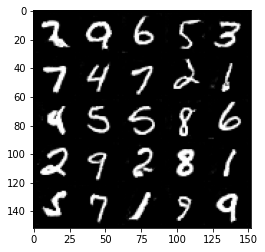

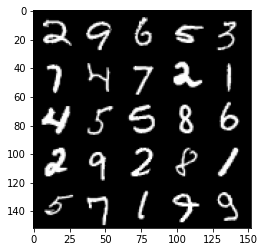

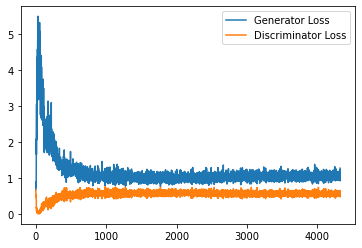

Epoch 185, step 87000: Generator loss: 1.068596752166748, discriminator loss: 0.5776560890078545


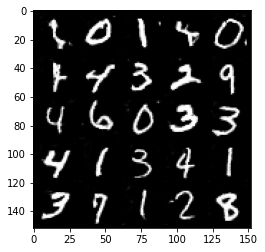

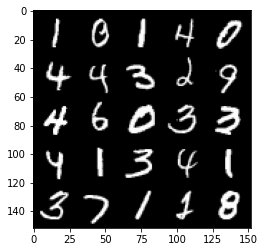

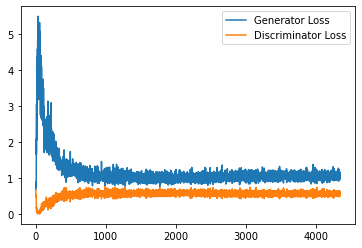

Epoch 186, step 87500: Generator loss: 1.0789172254800796, discriminator loss: 0.5775030149221421


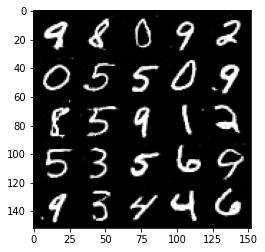

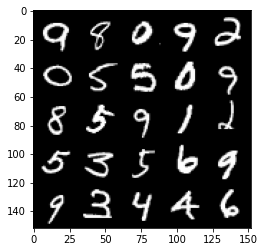

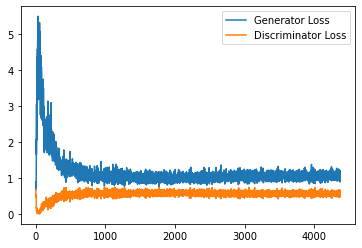

Epoch 187, step 88000: Generator loss: 1.0394533749818802, discriminator loss: 0.5779588878154754


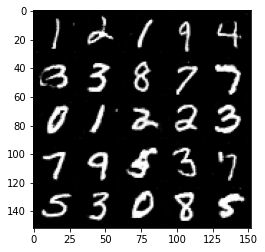

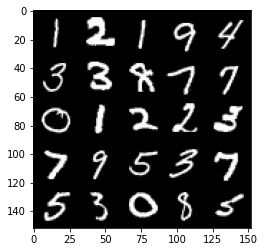

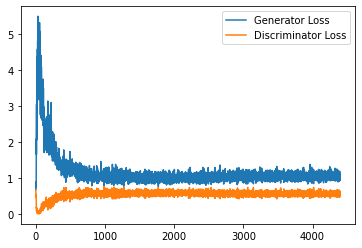

Epoch 188, step 88500: Generator loss: 1.0549224185943604, discriminator loss: 0.5807414393424988


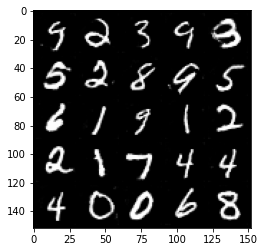

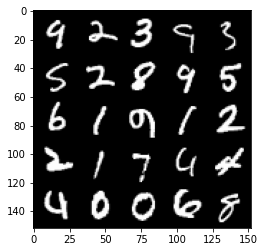

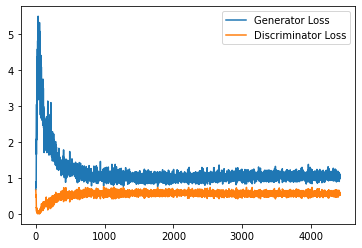

Epoch 189, step 89000: Generator loss: 1.0615550152063369, discriminator loss: 0.5767884857654572


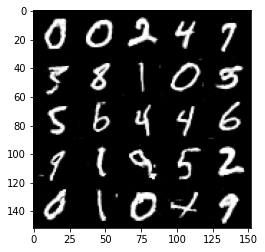

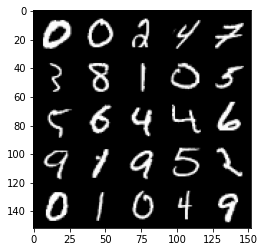

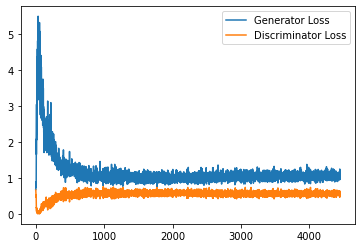

Epoch 190, step 89500: Generator loss: 1.0812715271711348, discriminator loss: 0.5780847406387329


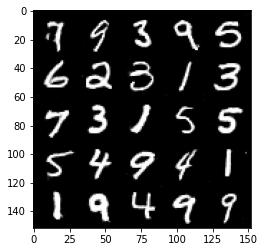

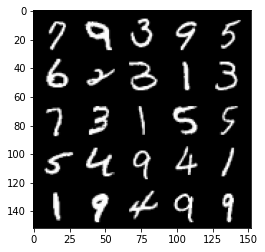

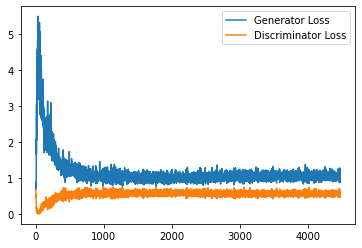

Epoch 191, step 90000: Generator loss: 1.0750320048332214, discriminator loss: 0.5746859630346298


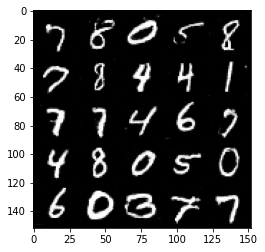

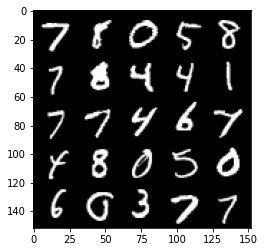

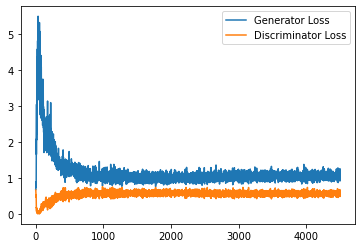

Epoch 192, step 90500: Generator loss: 1.0539144518375396, discriminator loss: 0.5834922134280205


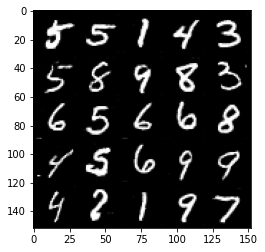

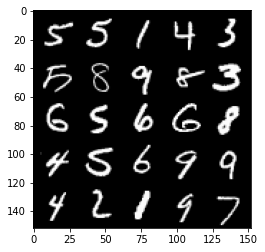

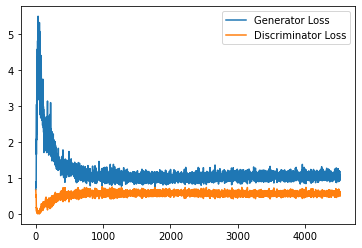

Epoch 194, step 91000: Generator loss: 1.0434584177732467, discriminator loss: 0.5828267520666123


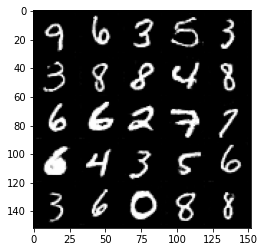

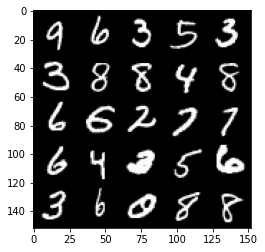

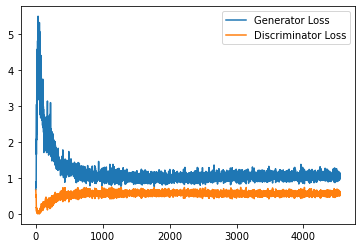

Epoch 195, step 91500: Generator loss: 1.0610374666452407, discriminator loss: 0.5786162666082382


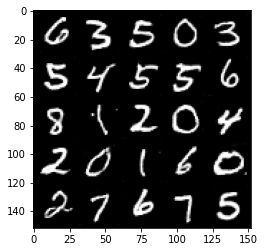

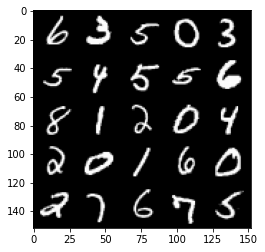

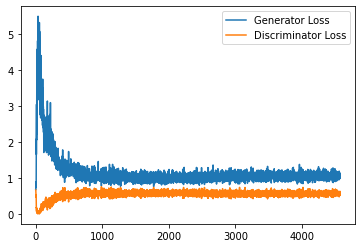

Epoch 196, step 92000: Generator loss: 1.0798625395298005, discriminator loss: 0.5821059190034866


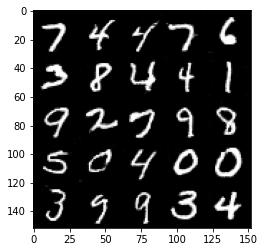

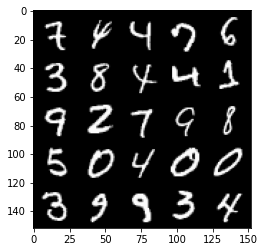

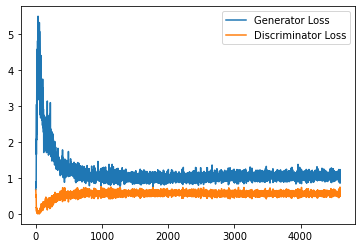

Epoch 197, step 92500: Generator loss: 1.0505787365436554, discriminator loss: 0.5853755978345871


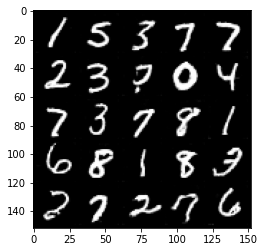

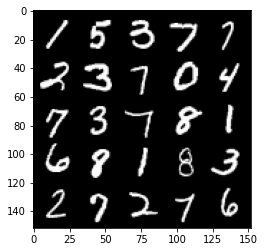

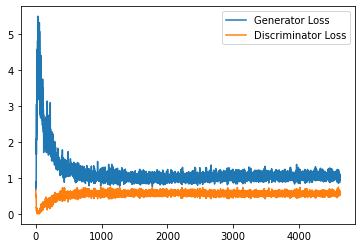

Epoch 198, step 93000: Generator loss: 1.0634052627086639, discriminator loss: 0.5801824136972428


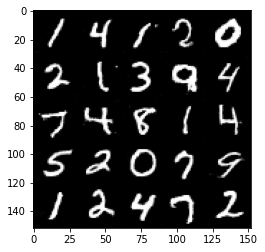

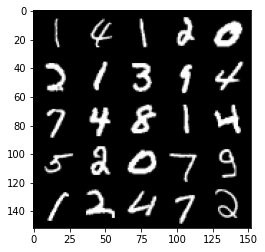

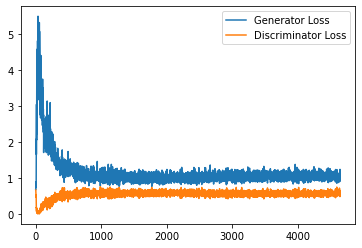

Epoch 199, step 93500: Generator loss: 1.0473858828544618, discriminator loss: 0.5884743331670761


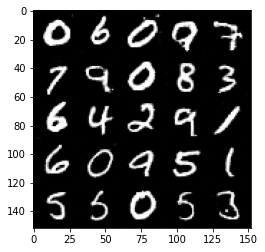

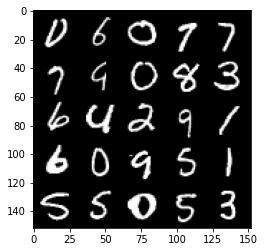

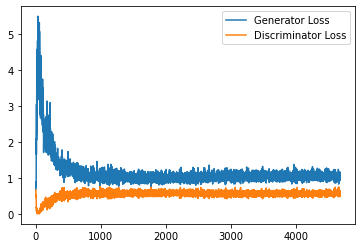

In [28]:
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [29]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

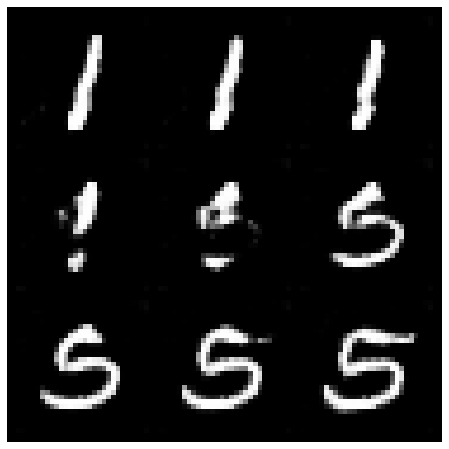

In [30]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

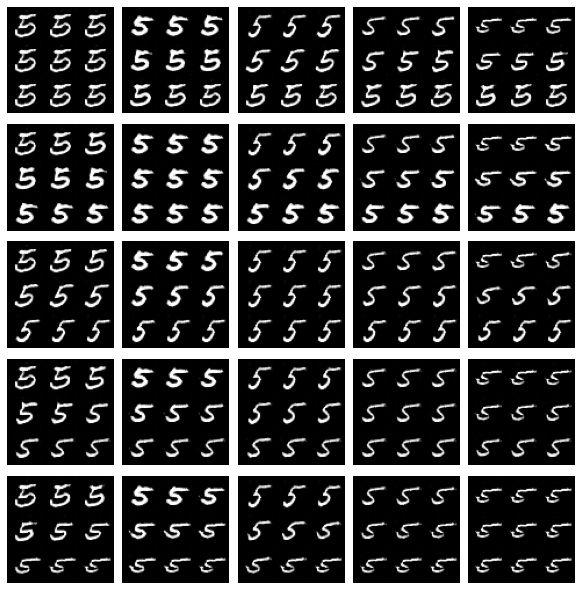

In [31]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()